**INTEGRACIÓN CURRICULAR**

**Pontificia Universidad Católica del Ecuador**

**Facultad de Ingeniería**

**Carrera de Sistemas de Información**

**TEMA: DETERMINAR LA ACELERACIÓN DEL TERRENO UTILIZANDO REDES NEURONALES ARTIFICIALES CON DATA SÍSMICA DE CALIFORNIA.**

### **Autor:** José Miguel Alviar Morales

### **Quito DM, JULIO DE 2024**

**LIBRERÍA TENSORFLOW**

In [ ]:
# Instalamos TensorFlow
!pip install tensorflow

**Matriz de Correlación**

In [ ]:
# Calculamos la matriz de correlación para todas las variables
correlation_matrix = df.corr()

# Mostramos la matriz de correlación
print("Matriz de Correlación:")
print(correlation_matrix)

Matriz de Correlación:
                                                    Record Sequence Number  \
Record Sequence Number                                            1.000000   
EQID                                                              0.893274   
YEAR                                                              0.490752   
MODY                                                             -0.144621   
HRMN                                                              0.118898   
Station Sequence Number                                           0.703801   
Earthquake Magnitude                                             -0.826154   
Magnitude Uncertainty: Kagan Model                               -0.659739   
Magnitude Sample Size                                            -0.473867   
Magnitude Uncertainty: Study Class                               -0.659736   
Mo (dyne.cm)                                                     -0.243470   
Strike (deg)                             

**Función de activación ReLU - 1 capa de entrada de 5 neuronas y 3 capas ocultas - 100 épocas - 80% entrenamiento - 20% prueba.**

In [ ]:
# Importamos las librerías necesarias
import numpy as np
import pandas as pd
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

# Cargamos el archivo CSV
url = '/content/DATA_PGA_050.csv'  # Ruta del archivo CSV
df = pd.read_csv(url)

# Seleccionamos solo las variables relevantes
df_selected = df[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis','HypD (km)', 'PGA (g)']]

# Mostramos las primeras filas del dataframe para verificar que se haya cargado correctamente
print(df_selected.head())

# Dividimos los datos en características (X) y etiquetas (y)
X = df_selected.drop('PGA (g)', axis=1).values
y = df_selected['PGA (g)'].values

# Dividimos los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Escalamos los datos
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Definimos el modelo de red neuronal
model = tf.keras.Sequential([
    tf.keras.layers.Dense(5, activation='relu', input_shape=(X_train.shape[1],)),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(32, activation='relu'),
    tf.keras.layers.Dense(16, activation='relu'),
    tf.keras.layers.Dense(1)
])

# Compilamos el modelo
model.compile(optimizer='adam', loss='mean_squared_error')

# Entrenamos el modelo
model.fit(X_train, y_train, epochs=100, batch_size=32, verbose=1)

# Evaluamos el modelo en el conjunto de prueba
mse = model.evaluate(X_test, y_test, verbose=0)
print('Mean Squared Error on Test Set:', mse)

# Calculamos las predicciones
y_pred = model.predict(X_test).flatten()

# Calculamos el coeficiente de determinación R cuadrado (R²)
r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R cuadrado (R²):', r2)

# Guardamos el modelo
model.save('modelo.h5')

   EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0       6.31                   6.0                              0   
1       6.31                   6.0                              0   
2      73.49                   5.8                              0   
3      33.20                   5.0                              0   
4      54.88                   5.5                              0   

   Vs30 (m/s) selected for analysis  HypD (km)  PGA (g)  
0                            593.35       8.71    0.157  
1                            551.82       8.71    0.046  
2                            219.31      74.17    0.041  
3                            213.44      36.86    0.018  
4                            219.31      55.78    0.122  
Epoch 1/100
530/530 [==============================] - 3s 3ms/step - loss: 0.0016
Epoch 2/100
530/530 [==============================] - 1s 2ms/step - loss: 0.0012
Epoch 3/100
530/530 [==============================] - 1s 2ms/step - loss

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


133/133 [==============================] - 0s 1ms/step


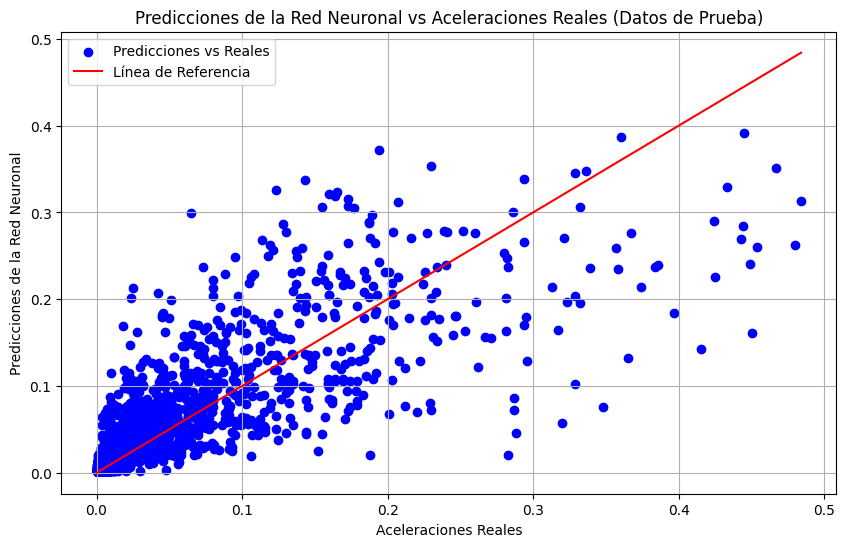

In [ ]:
import matplotlib.pyplot as plt

# Utiliza el modelo entrenado para predecir las aceleraciones utilizando los datos de prueba
y_pred = model.predict(X_test).flatten()

# Grafica las predicciones versus las aceleraciones reales
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', label='Predicciones vs Reales')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', label='Línea de Referencia')
plt.title('Predicciones de la Red Neuronal vs Aceleraciones Reales (Datos de Prueba)')
plt.xlabel('Aceleraciones Reales')
plt.ylabel('Predicciones de la Red Neuronal')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
# Predicciones de la red neuronal en el conjunto de prueba
predictions = model.predict(X_test).flatten()

# Agregar las predicciones como una nueva columna al conjunto de datos de prueba
df_test = pd.DataFrame(X_test, columns=df_selected.columns[:-1])  # Creamos un DataFrame con las características de prueba
df_test['PGA (g)'] = y_test  # Agregamos la variable original 'PGA (g)'
df_test['Predict RNA'] = predictions  # Agregamos las predicciones como una nueva columna


# Mostrar todo el dataset con las predicciones
print(df_test)


Se han truncado las últimas 5000 líneas del flujo de salida.
3482  -0.658281             -0.752263                      -0.769207   
3483  -0.969354             -0.966723                       1.556381   
3484  -0.940674             -0.172427                      -0.769207   
3485  -1.022038             -0.513974                      -0.769207   
3486  -0.570828              1.551195                       0.781185   
3487   0.381451              2.123088                       1.556381   
3488  -0.375801             -0.919065                       0.005989   
3489  -0.718907             -1.228840                       1.556381   
3490   0.357713             -0.196256                      -0.769207   
3491  -0.587772             -1.157353                      -0.769207   
3492  -0.845896             -0.664890                      -0.769207   
3493   0.604982             -0.990551                      -0.769207   
3494   1.992675              1.630624                      -0.769207   
349

In [ ]:
# Ajustar la configuración de visualización para mostrar todas las filas
pd.set_option('display.max_rows', None)
# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.971648              0.121463                       0.005989   
1      0.827013              1.320849                      -0.769207   
2      2.732984             -0.831692                       2.331577   
3     -0.991328             -0.196256                      -0.769207   
4      1.092991              1.471765                       0.781185   
5     -0.773003              0.995188                      -0.769207   
6     -0.378537              0.995188                       0.781185   
7     -0.743970             -0.752263                      -0.769207   
8      1.211772              1.789483                      -0.769207   
9      5.490455              2.345490                       1.556381   
10    -0.427338             -0.172427                      -0.769207   
11     0.291703             -1.038209                       1.556381   
12    -0.056433             -0.545746                      -0.76

In [ ]:
# Cargar el archivo CSV de validación
url_validacion = '/content/DATA_VALIDACION_200.csv'
df_validacion = pd.read_csv(url_validacion)

# Seleccionar solo las variables relevantes para la predicción
df_validacion_selected = df_validacion[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis', 'HypD (km)']]

# Escalar los datos de validación
X_validacion = scaler.transform(df_validacion_selected.values)

# Realizar las predicciones con el modelo de red neuronal
predictions_validacion = model.predict(X_validacion).flatten()

# Agregar las predicciones como una nueva columna al conjunto de datos de validación
df_validacion['Predict RNA'] = predictions_validacion

# Mostrar el conjunto de datos de validación con las predicciones
print(df_validacion)


7/7 [==============================] - 0s 3ms/step
     Earthquake Magnitude  Mechanism Based on Rake Angle  EpiD (km)  \
0                    4.11                              1     215.19   
1                    4.11                              1     136.41   
2                    4.11                              1     146.01   
3                    4.11                              1     149.06   
4                    4.11                              1     135.25   
5                    4.11                              1     217.00   
6                    4.11                              1      92.01   
7                    4.11                              1     101.28   
8                    4.11                              1     179.19   
9                    4.11                              1     120.89   
10                   4.11                              1     179.25   
11                   4.11                              1     174.66   
12                   4.11 

**MÉTRICAS DE EVALUACIÓN**

**R2**

In [ ]:
from sklearn.metrics import r2_score

# Calculamos el coeficiente de determinación R²
r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R²:', r2)

Coeficiente de determinación R²: 0.6803656454252669


**MSE**

In [ ]:
from sklearn.metrics import mean_squared_error

# Calculamos el Error Cuadrático Medio (MSE)
mse = mean_squared_error(y_test, y_pred)
print('Error Cuadrático Medio (MSE):', mse)

Error Cuadrático Medio (MSE): 0.0009577693473059045


**RMSE**

In [ ]:
import numpy as np

# Calculamos la Raíz del Error Cuadrático Medio (RMSE)
rmse = np.sqrt(mse)
print('Raíz del Error Cuadrático Medio (RMSE):', rmse)

Raíz del Error Cuadrático Medio (RMSE): 0.03094784883163779


**RMSLE**

In [ ]:
from sklearn.metrics import mean_squared_log_error
y_test_positive = y_test + 1
y_pred_positive = y_pred + 1

# Calculamos el Error Cuadrático Logarítmico Medio (RMSLE)
rmsle = np.sqrt(mean_squared_log_error(y_test_positive, y_pred_positive))
print('Root Mean Squared Logarithmic Error (RMSLE):', rmsle)

Root Mean Squared Logarithmic Error (RMSLE): 0.026684673682485987


**MAE**

In [ ]:
from sklearn.metrics import mean_absolute_error

# Calculamos el Error Absoluto Medio (MAE)
mae = mean_absolute_error(y_test, y_pred)
print('Error Absoluto Medio (MAE):', mae)

Error Absoluto Medio (MAE): 0.013447344186042988


**Pérdida durante el Entrenamiento**

Epoch 1/200
424/424 [==============================] - 7s 11ms/step - loss: 0.0023 - val_loss: 0.0013
Epoch 2/200
424/424 [==============================] - 3s 7ms/step - loss: 0.0014 - val_loss: 0.0012
Epoch 3/200
424/424 [==============================] - 2s 5ms/step - loss: 0.0013 - val_loss: 0.0012
Epoch 4/200
424/424 [==============================] - 3s 7ms/step - loss: 0.0013 - val_loss: 0.0012
Epoch 5/200
424/424 [==============================] - 2s 6ms/step - loss: 0.0012 - val_loss: 0.0011
Epoch 6/200
424/424 [==============================] - 3s 8ms/step - loss: 0.0011 - val_loss: 0.0011
Epoch 7/200
424/424 [==============================] - 2s 4ms/step - loss: 0.0011 - val_loss: 0.0011
Epoch 8/200
424/424 [==============================] - 2s 4ms/step - loss: 0.0011 - val_loss: 0.0010
Epoch 9/200
424/424 [==============================] - 2s 4ms/step - loss: 0.0011 - val_loss: 0.0011
Epoch 10/200
424/424 [==============================] - 3s 7ms/step - loss: 0.0011 - val_l

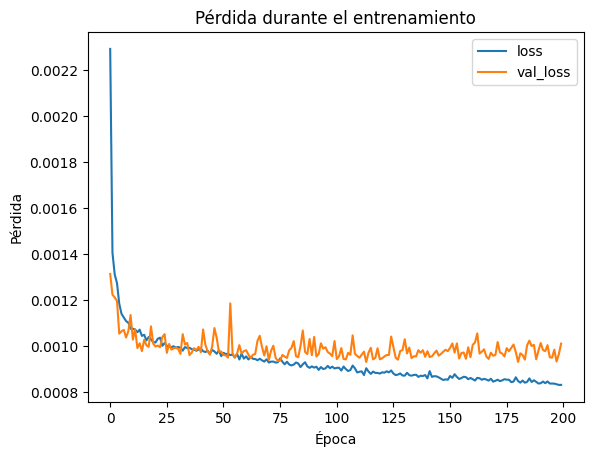

In [ ]:
# Definimos el modelo de red neuronal
model = tf.keras.Sequential([
    tf.keras.layers.Dense(5, activation='relu', input_shape=(X_train.shape[1],)),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(32, activation='relu'),
    tf.keras.layers.Dense(16, activation='relu'),
    tf.keras.layers.Dense(1)
])

# Compilamos el modelo
model.compile(optimizer='adam', loss='mean_squared_error')

# Entrenamos el modelo con más épocas
history = model.fit(X_train, y_train, epochs=200, batch_size=32, verbose=1, validation_split=0.2)

# Evaluamos el modelo en el conjunto de prueba
mse = model.evaluate(X_test, y_test, verbose=0)
print('Mean Squared Error on Test Set:', mse)

# Calculamos las predicciones
y_pred = model.predict(X_test).flatten()

# Calculamos el coeficiente de determinación R cuadrado (R²)
r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R cuadrado (R²):', r2)

# Graficamos la pérdida durante el entrenamiento
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.title('Pérdida durante el entrenamiento')
plt.xlabel('Época')
plt.ylabel('Pérdida')
plt.legend()
plt.show()

**Función de activación ReLU - 1 capa de entrada de 5 neuronas y 3 capas ocultas - 100 épocas - 70% entrenamiento - 30% prueba.**

In [ ]:
# Importamos las librerías necesarias
import numpy as np
import pandas as pd
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

# Cargamos el archivo CSV
url = '/content/DATA_PGA_050.csv'  # Ruta del archivo CSV
df = pd.read_csv(url)

# Seleccionamos solo las variables relevantes
df_selected = df[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis','HypD (km)', 'PGA (g)']]

# Mostramos las primeras filas del dataframe para verificar que se haya cargado correctamente
print(df_selected.head())

# Dividimos los datos en características (X) y etiquetas (y)
X = df_selected.drop('PGA (g)', axis=1).values
y = df_selected['PGA (g)'].values

# Dividimos los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Escalamos los datos
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Definimos el modelo de red neuronal
model = tf.keras.Sequential([
    tf.keras.layers.Dense(5, activation='relu', input_shape=(X_train.shape[1],)),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(32, activation='relu'),
    tf.keras.layers.Dense(16, activation='relu'),
    tf.keras.layers.Dense(1)
])

# Compilamos el modelo
model.compile(optimizer='adam', loss='mean_squared_error')

# Entrenamos el modelo
model.fit(X_train, y_train, epochs=100, batch_size=32, verbose=1)

# Evaluamos el modelo en el conjunto de prueba
mse = model.evaluate(X_test, y_test, verbose=0)
print('Mean Squared Error on Test Set:', mse)

# Calculamos las predicciones
y_pred = model.predict(X_test).flatten()

# Calculamos el coeficiente de determinación R cuadrado (R²)
r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R cuadrado (R²):', r2)

# Guardamos el modelo
model.save('modelo.h5')

   EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0       6.31                   6.0                              0   
1       6.31                   6.0                              0   
2      73.49                   5.8                              0   
3      33.20                   5.0                              0   
4      54.88                   5.5                              0   

   Vs30 (m/s) selected for analysis  HypD (km)  PGA (g)  
0                            593.35       8.71    0.157  
1                            551.82       8.71    0.046  
2                            219.31      74.17    0.041  
3                            213.44      36.86    0.018  
4                            219.31      55.78    0.122  
Epoch 1/100
464/464 [==============================] - 2s 2ms/step - loss: 0.0025
Epoch 2/100
464/464 [==============================] - 1s 2ms/step - loss: 0.0015
Epoch 3/100
464/464 [==============================] - 1s 2ms/step - loss

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


199/199 [==============================] - 0s 1ms/step


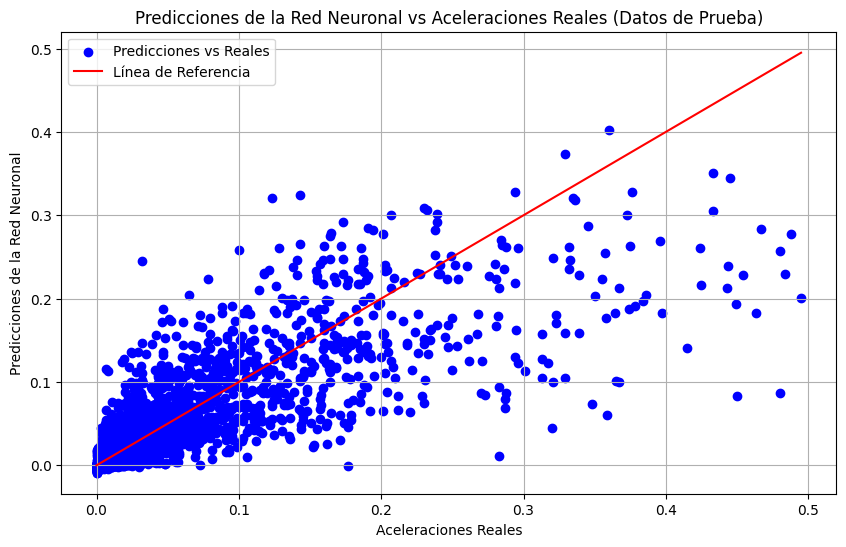

In [ ]:
import matplotlib.pyplot as plt

# Utiliza el modelo entrenado para predecir las aceleraciones utilizando los datos de prueba
y_pred = model.predict(X_test).flatten()

# Grafica las predicciones versus las aceleraciones reales
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', label='Predicciones vs Reales')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', label='Línea de Referencia')
plt.title('Predicciones de la Red Neuronal vs Aceleraciones Reales (Datos de Prueba)')
plt.xlabel('Aceleraciones Reales')
plt.ylabel('Predicciones de la Red Neuronal')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
# Predicciones de la red neuronal en el conjunto de prueba
predictions = model.predict(X_test).flatten()

# Agregar las predicciones como una nueva columna al conjunto de datos de prueba
df_test = pd.DataFrame(X_test, columns=df_selected.columns[:-1])  # Creamos un DataFrame con las características de prueba
df_test['PGA (g)'] = y_test  # Agregamos la variable original 'PGA (g)'
df_test['Predict RNA'] = predictions  # Agregamos las predicciones como una nueva columna


# Mostrar todo el dataset con las predicciones
print(df_test)

Se han truncado las últimas 5000 líneas del flujo de salida.
1360                          1.493745   9.053769    0.008 -4.710885e-03  
1361                         -0.266758  -0.493109    0.001 -1.120185e-03  
1362                         -0.819493  -0.809510    0.106  1.072835e-01  
1363                          0.200000  -0.800920    0.012  7.101677e-03  
1364                         -0.425200  -0.927568    0.009  2.150123e-03  
1365                          2.345363  -0.206158    0.000 -5.959561e-04  
1366                         -1.091705   1.896809    0.000 -1.407004e-03  
1367                         -0.260128   1.066105    0.002 -5.553756e-04  
1368                         -0.123309   1.425364    0.012  6.809107e-03  
1369                          1.493745  -0.754118    0.001  1.600044e-02  
1370                         -0.913579   0.571521    0.007  1.663928e-02  
1371                         -0.194192  -0.368127    0.000 -7.336638e-04  
1372                          0.183172 

In [ ]:
# Ajustar la configuración de visualización para mostrar todas las filas
pd.set_option('display.max_rows', None)
# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.958670              0.121924                       0.004438   
1      0.819170              1.320204                      -0.770187   
2      2.703078             -0.830352                       2.328313   
3     -0.978122             -0.195501                      -0.770187   
4      1.082070              1.470981                       0.779063   
5     -0.762324              0.994843                      -0.770187   
6     -0.372424              0.994843                       0.779063   
7     -0.733627             -0.750995                      -0.770187   
8      1.199476              1.788406                      -0.770187   
9      5.428629              2.343900                       1.553688   
10    -0.420660             -0.171695                      -0.770187   
11     0.290057             -1.036678                       1.553688   
12    -0.054049             -0.544669                      -0.77

In [ ]:
# Cargar el archivo CSV de validación
url_validacion = '/content/DATA_VALIDACION_200.csv'
df_validacion = pd.read_csv(url_validacion)

# Seleccionar solo las variables relevantes para la predicción
df_validacion_selected = df_validacion[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis', 'HypD (km)']]

# Escalar los datos de validación
X_validacion = scaler.transform(df_validacion_selected.values)

# Realizar las predicciones con el modelo de red neuronal
predictions_validacion = model.predict(X_validacion).flatten()

# Agregar las predicciones como una nueva columna al conjunto de datos de validación
df_validacion['Predict RNA'] = predictions_validacion

# Mostrar el conjunto de datos de validación con las predicciones
print(df_validacion)

**MÉTRICAS DE EVALUACIÓN**

**R2**

In [ ]:
from sklearn.metrics import r2_score

# Calculamos el coeficiente de determinación R²
r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R²:', r2)

Coeficiente de determinación R²: 0.7100606507373683


**MSE**

In [ ]:
from sklearn.metrics import mean_squared_error

# Calculamos el Error Cuadrático Medio (MSE)
mse = mean_squared_error(y_test, y_pred)
print('Error Cuadrático Medio (MSE):', mse)

Error Cuadrático Medio (MSE): 0.0008949069224146252


**RMSE**

In [ ]:
import numpy as np

# Calculamos la Raíz del Error Cuadrático Medio (RMSE)
rmse = np.sqrt(mse)
print('Raíz del Error Cuadrático Medio (RMSE):', rmse)

Raíz del Error Cuadrático Medio (RMSE): 0.02991499494258064


**RMSLE**

In [ ]:
from sklearn.metrics import mean_squared_log_error
y_test_positive = y_test + 1
y_pred_positive = y_pred + 1

# Calculamos el Error Cuadrático Logarítmico Medio (RMSLE)
rmsle = np.sqrt(mean_squared_log_error(y_test_positive, y_pred_positive))
print('Root Mean Squared Logarithmic Error (RMSLE):', rmsle)

Root Mean Squared Logarithmic Error (RMSLE): 0.013741752467127881


**MAE**

In [ ]:
from sklearn.metrics import mean_absolute_error

# Calculamos el Error Absoluto Medio (MAE)
mae = mean_absolute_error(y_test, y_pred)
print('Error Absoluto Medio (MAE):', mae)

Error Absoluto Medio (MAE): 0.012147477296984949


**Función de activación ReLU - 1 capa de entrada de 5 neuronas y 3 capas ocultas - 100 épocas - 90% entrenamiento - 10% prueba.**

In [ ]:
# Importamos las librerías necesarias
import numpy as np
import pandas as pd
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

# Cargamos el archivo CSV
url = '/content/DATA_PGA_050.csv'  # Ruta del archivo CSV
df = pd.read_csv(url)

# Seleccionamos solo las variables relevantes
df_selected = df[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis','HypD (km)', 'PGA (g)']]

# Mostramos las primeras filas del dataframe para verificar que se haya cargado correctamente
print(df_selected.head())

# Dividimos los datos en características (X) y etiquetas (y)
X = df_selected.drop('PGA (g)', axis=1).values
y = df_selected['PGA (g)'].values

# Dividimos los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42)

# Escalamos los datos
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Definimos el modelo de red neuronal
model = tf.keras.Sequential([
    tf.keras.layers.Dense(5, activation='relu', input_shape=(X_train.shape[1],)),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(32, activation='relu'),
    tf.keras.layers.Dense(16, activation='relu'),
    tf.keras.layers.Dense(1)
])

# Compilamos el modelo
model.compile(optimizer='adam', loss='mean_squared_error')

# Entrenamos el modelo
model.fit(X_train, y_train, epochs=100, batch_size=32, verbose=1)

# Evaluamos el modelo en el conjunto de prueba
mse = model.evaluate(X_test, y_test, verbose=0)
print('Mean Squared Error on Test Set:', mse)

# Calculamos las predicciones
y_pred = model.predict(X_test).flatten()

# Calculamos el coeficiente de determinación R cuadrado (R²)
r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R cuadrado (R²):', r2)

# Guardamos el modelo
model.save('modelo.h5')

   EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0       6.31                   6.0                              0   
1       6.31                   6.0                              0   
2      73.49                   5.8                              0   
3      33.20                   5.0                              0   
4      54.88                   5.5                              0   

   Vs30 (m/s) selected for analysis  HypD (km)  PGA (g)  
0                            593.35       8.71    0.157  
1                            551.82       8.71    0.046  
2                            219.31      74.17    0.041  
3                            213.44      36.86    0.018  
4                            219.31      55.78    0.122  
Epoch 1/100
597/597 [==============================] - 3s 2ms/step - loss: 0.0016
Epoch 2/100
597/597 [==============================] - 1s 2ms/step - loss: 0.0012
Epoch 3/100
597/597 [==============================] - 1s 2ms/step - loss

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 0s 1ms/step


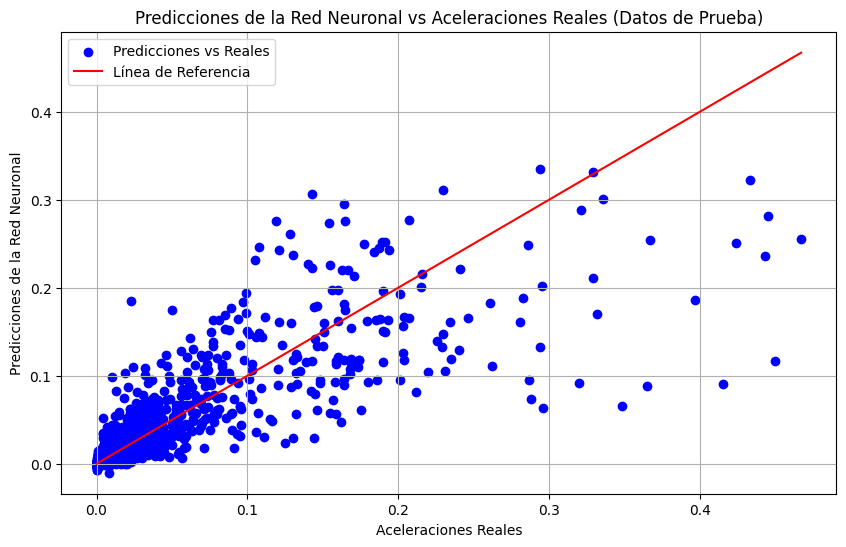

In [ ]:
import matplotlib.pyplot as plt

# Utiliza el modelo entrenado para predecir las aceleraciones utilizando los datos de prueba
y_pred = model.predict(X_test).flatten()

# Grafica las predicciones versus las aceleraciones reales
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', label='Predicciones vs Reales')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', label='Línea de Referencia')
plt.title('Predicciones de la Red Neuronal vs Aceleraciones Reales (Datos de Prueba)')
plt.xlabel('Aceleraciones Reales')
plt.ylabel('Predicciones de la Red Neuronal')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
# Predicciones de la red neuronal en el conjunto de prueba
predictions = model.predict(X_test).flatten()

# Agregar las predicciones como una nueva columna al conjunto de datos de prueba
df_test = pd.DataFrame(X_test, columns=df_selected.columns[:-1])  # Creamos un DataFrame con las características de prueba
df_test['PGA (g)'] = y_test  # Agregamos la variable original 'PGA (g)'
df_test['Predict RNA'] = predictions  # Agregamos las predicciones como una nueva columna


# Mostrar todo el dataset con las predicciones
print(df_test)

67/67 [==============================] - 0s 1ms/step
      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.968945              0.122893                       0.005614   
1      0.825426              1.321808                      -0.770449   
2      2.726850             -0.829887                       2.333802   
3     -0.988577             -0.194700                      -0.770449   
4      1.090769              1.472665                       0.781676   
5     -0.770774              0.996275                      -0.770449   
6     -0.377248              0.996275                       0.781676   
7     -0.741810             -0.750488                      -0.770449   
8      1.209267              1.790258                      -0.770449   
9      5.477743              2.346047                       1.557739   
10    -0.425933             -0.170881                      -0.770449   
11     0.291393             -1.036323                       1.557739   
12    -0.05

In [ ]:
# Ajustar la configuración de visualización para mostrar todas las filas
pd.set_option('display.max_rows', None)
# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.968945              0.122893                       0.005614   
1      0.825426              1.321808                      -0.770449   
2      2.726850             -0.829887                       2.333802   
3     -0.988577             -0.194700                      -0.770449   
4      1.090769              1.472665                       0.781676   
5     -0.770774              0.996275                      -0.770449   
6     -0.377248              0.996275                       0.781676   
7     -0.741810             -0.750488                      -0.770449   
8      1.209267              1.790258                      -0.770449   
9      5.477743              2.346047                       1.557739   
10    -0.425933             -0.170881                      -0.770449   
11     0.291393             -1.036323                       1.557739   
12    -0.055913             -0.544053                      -0.77

In [ ]:
# Cargar el archivo CSV de validación
url_validacion = '/content/DATA_VALIDACION_200.csv'
df_validacion = pd.read_csv(url_validacion)

# Seleccionar solo las variables relevantes para la predicción
df_validacion_selected = df_validacion[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis', 'HypD (km)']]

# Escalar los datos de validación
X_validacion = scaler.transform(df_validacion_selected.values)

# Realizar las predicciones con el modelo de red neuronal
predictions_validacion = model.predict(X_validacion).flatten()

# Agregar las predicciones como una nueva columna al conjunto de datos de validación
df_validacion['Predict RNA'] = predictions_validacion

# Mostrar el conjunto de datos de validación con las predicciones
print(df_validacion)

7/7 [==============================] - 0s 3ms/step
     Earthquake Magnitude  Mechanism Based on Rake Angle  EpiD (km)  \
0                    4.11                              1     215.19   
1                    4.11                              1     136.41   
2                    4.11                              1     146.01   
3                    4.11                              1     149.06   
4                    4.11                              1     135.25   
5                    4.11                              1     217.00   
6                    4.11                              1      92.01   
7                    4.11                              1     101.28   
8                    4.11                              1     179.19   
9                    4.11                              1     120.89   
10                   4.11                              1     179.25   
11                   4.11                              1     174.66   
12                   4.11 

**MÉTRICAS DE EVALUACIÓN**

**R2**

In [ ]:
from sklearn.metrics import r2_score

# Calculamos el coeficiente de determinación R²
r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R²:', r2)

Coeficiente de determinación R²: 0.7020564672384448


**MSE**

In [ ]:
from sklearn.metrics import mean_squared_error

# Calculamos el Error Cuadrático Medio (MSE)
mse = mean_squared_error(y_test, y_pred)
print('Error Cuadrático Medio (MSE):', mse)

Error Cuadrático Medio (MSE): 0.0009194669591700189


**RMSE**

In [ ]:
import numpy as np

# Calculamos la Raíz del Error Cuadrático Medio (RMSE)
rmse = np.sqrt(mse)
print('Raíz del Error Cuadrático Medio (RMSE):', rmse)

Raíz del Error Cuadrático Medio (RMSE): 0.030322713585199113


**RMSLE**

In [ ]:
from sklearn.metrics import mean_squared_log_error
y_test_positive = y_test + 1
y_pred_positive = y_pred + 1

# Calculamos el Error Cuadrático Logarítmico Medio (RMSLE)
rmsle = np.sqrt(mean_squared_log_error(y_test_positive, y_pred_positive))
print('Root Mean Squared Logarithmic Error (RMSLE):', rmsle)

Root Mean Squared Logarithmic Error (RMSLE): 0.01391926084919071


**MAE**

In [ ]:
from sklearn.metrics import mean_absolute_error

# Calculamos el Error Absoluto Medio (MAE)
mae = mean_absolute_error(y_test, y_pred)
print('Error Absoluto Medio (MAE):', mae)

Error Absoluto Medio (MAE): 0.011903086741458414


**Función de activación Tangente Hipérbolica - 1 capa de entrada de 5 neuronas y 3 capas ocultas - 100 épocas - 80% entrenamiento - 20% prueba.**

In [ ]:
# Importamos las librerías necesarias
import numpy as np
import pandas as pd
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

# Cargamos el archivo CSV
url = '/content/DATA_PGA_050.csv'  # Ruta del archivo CSV
df = pd.read_csv(url)

# Seleccionamos solo las variables relevantes
df_selected = df[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis','HypD (km)', 'PGA (g)']]

# Mostramos las primeras filas del dataframe para verificar que se haya cargado correctamente
print(df_selected.head())

# Dividimos los datos en características (X) y etiquetas (y)
X = df_selected.drop('PGA (g)', axis=1).values
y = df_selected['PGA (g)'].values

# Dividimos los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Escalamos los datos
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Definimos el modelo de red neuronal
model = tf.keras.Sequential([
    tf.keras.layers.Dense(5, activation='tanh', input_shape=(X_train.shape[1],)),
    tf.keras.layers.Dense(64, activation='tanh'),
    tf.keras.layers.Dense(32, activation='tanh'),
    tf.keras.layers.Dense(16, activation='tanh'),
    tf.keras.layers.Dense(1)
])

# Compilamos el modelo
model.compile(optimizer='adam', loss='mean_squared_error')

# Entrenamos el modelo
model.fit(X_train, y_train, epochs=100, batch_size=32, verbose=1)

# Evaluamos el modelo en el conjunto de prueba
mse = model.evaluate(X_test, y_test, verbose=0)
print('Mean Squared Error on Test Set:', mse)

# Calculamos las predicciones
y_pred = model.predict(X_test).flatten()

# Calculamos el coeficiente de determinación R cuadrado (R²)
r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R cuadrado (R²):', r2)

# Guardamos el modelo
model.save('modelo.h5')

   EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0       6.31                   6.0                              0   
1       6.31                   6.0                              0   
2      73.49                   5.8                              0   
3      33.20                   5.0                              0   
4      54.88                   5.5                              0   

   Vs30 (m/s) selected for analysis  HypD (km)  PGA (g)  
0                            593.35       8.71    0.157  
1                            551.82       8.71    0.046  
2                            219.31      74.17    0.041  
3                            213.44      36.86    0.018  
4                            219.31      55.78    0.122  
Epoch 1/100
530/530 [==============================] - 2s 2ms/step - loss: 0.0026
Epoch 2/100
530/530 [==============================] - 1s 2ms/step - loss: 0.0020
Epoch 3/100
530/530 [==============================] - 1s 2ms/step - loss

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


133/133 [==============================] - 0s 1ms/step


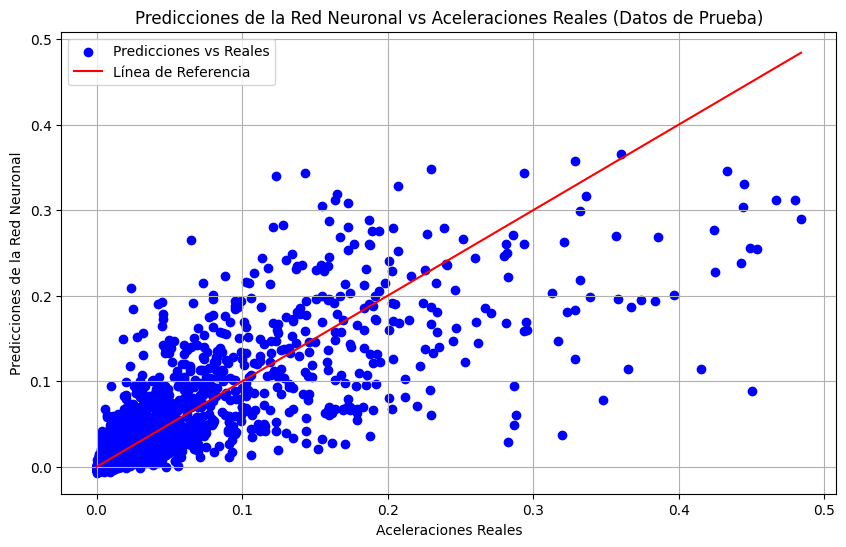

In [ ]:
import matplotlib.pyplot as plt

# Utiliza el modelo entrenado para predecir las aceleraciones utilizando los datos de prueba
y_pred = model.predict(X_test).flatten()

# Grafica las predicciones versus las aceleraciones reales
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', label='Predicciones vs Reales')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', label='Línea de Referencia')
plt.title('Predicciones de la Red Neuronal vs Aceleraciones Reales (Datos de Prueba)')
plt.xlabel('Aceleraciones Reales')
plt.ylabel('Predicciones de la Red Neuronal')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
# Predicciones de la red neuronal en el conjunto de prueba
predictions = model.predict(X_test).flatten()

# Agregar las predicciones como una nueva columna al conjunto de datos de prueba
df_test = pd.DataFrame(X_test, columns=df_selected.columns[:-1])  # Creamos un DataFrame con las características de prueba
df_test['PGA (g)'] = y_test  # Agregamos la variable original 'PGA (g)'
df_test['Predict RNA'] = predictions  # Agregamos las predicciones como una nueva columna


# Mostrar todo el dataset con las predicciones
print(df_test)

Se han truncado las últimas 5000 líneas del flujo de salida.
3482  -0.658281             -0.752263                      -0.769207   
3483  -0.969354             -0.966723                       1.556381   
3484  -0.940674             -0.172427                      -0.769207   
3485  -1.022038             -0.513974                      -0.769207   
3486  -0.570828              1.551195                       0.781185   
3487   0.381451              2.123088                       1.556381   
3488  -0.375801             -0.919065                       0.005989   
3489  -0.718907             -1.228840                       1.556381   
3490   0.357713             -0.196256                      -0.769207   
3491  -0.587772             -1.157353                      -0.769207   
3492  -0.845896             -0.664890                      -0.769207   
3493   0.604982             -0.990551                      -0.769207   
3494   1.992675              1.630624                      -0.769207   
349

In [ ]:
# Ajustar la configuración de visualización para mostrar todas las filas
pd.set_option('display.max_rows', None)
# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.971648              0.121463                       0.005989   
1      0.827013              1.320849                      -0.769207   
2      2.732984             -0.831692                       2.331577   
3     -0.991328             -0.196256                      -0.769207   
4      1.092991              1.471765                       0.781185   
5     -0.773003              0.995188                      -0.769207   
6     -0.378537              0.995188                       0.781185   
7     -0.743970             -0.752263                      -0.769207   
8      1.211772              1.789483                      -0.769207   
9      5.490455              2.345490                       1.556381   
10    -0.427338             -0.172427                      -0.769207   
11     0.291703             -1.038209                       1.556381   
12    -0.056433             -0.545746                      -0.76

In [ ]:
# Cargar el archivo CSV de validación
url_validacion = '/content/DATA_VALIDACION_200.csv'
df_validacion = pd.read_csv(url_validacion)

# Seleccionar solo las variables relevantes para la predicción
df_validacion_selected = df_validacion[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis', 'HypD (km)']]

# Escalar los datos de validación
X_validacion = scaler.transform(df_validacion_selected.values)

# Realizar las predicciones con el modelo de red neuronal
predictions_validacion = model.predict(X_validacion).flatten()

# Agregar las predicciones como una nueva columna al conjunto de datos de validación
df_validacion['Predict RNA'] = predictions_validacion

# Mostrar el conjunto de datos de validación con las predicciones
print(df_validacion)

7/7 [==============================] - 0s 4ms/step
     Earthquake Magnitude  Mechanism Based on Rake Angle  EpiD (km)  \
0                    4.11                              1     215.19   
1                    4.11                              1     136.41   
2                    4.11                              1     146.01   
3                    4.11                              1     149.06   
4                    4.11                              1     135.25   
5                    4.11                              1     217.00   
6                    4.11                              1      92.01   
7                    4.11                              1     101.28   
8                    4.11                              1     179.19   
9                    4.11                              1     120.89   
10                   4.11                              1     179.25   
11                   4.11                              1     174.66   
12                   4.11 

**MÉTRICAS DE EVALUACIÓN**

**R2**

In [ ]:
from sklearn.metrics import r2_score

# Calculamos el coeficiente de determinación R²
r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R²:', r2)

Coeficiente de determinación R²: 0.6907245977923595


**MSE**

In [ ]:
from sklearn.metrics import mean_squared_error

# Calculamos el Error Cuadrático Medio (MSE)
mse = mean_squared_error(y_test, y_pred)
print('Error Cuadrático Medio (MSE):', mse)

Error Cuadrático Medio (MSE): 0.0009267292325453884


**RMSE**

In [ ]:
import numpy as np

# Calculamos la Raíz del Error Cuadrático Medio (RMSE)
rmse = np.sqrt(mse)
print('Raíz del Error Cuadrático Medio (RMSE):', rmse)

Raíz del Error Cuadrático Medio (RMSE): 0.0304422277855184


**RMSLE**

In [ ]:
from sklearn.metrics import mean_squared_log_error
y_test_positive = y_test + 1
y_pred_positive = y_pred + 1

# Calculamos el Error Cuadrático Logarítmico Medio (RMSLE)
rmsle = np.sqrt(mean_squared_log_error(y_test_positive, y_pred_positive))
print('Root Mean Squared Logarithmic Error (RMSLE):', rmsle)

Root Mean Squared Logarithmic Error (RMSLE): 0.014041804383711777


**MAE**

In [ ]:
from sklearn.metrics import mean_absolute_error

# Calculamos el Error Absoluto Medio (MAE)
mae = mean_absolute_error(y_test, y_pred)
print('Error Absoluto Medio (MAE):', mae)

Error Absoluto Medio (MAE): 0.012999376673434142


**Función de activación Sigmoide - 1 capa de entrada de 5 neuronas y 3 capas ocultas - 100 épocas - 80% entrenamiento - 20% prueba.**

In [ ]:
# Importamos las librerías necesarias
import numpy as np
import pandas as pd
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

# Cargamos el archivo CSV
url = '/content/DATA_PGA_050.csv'  # Ruta del archivo CSV
df = pd.read_csv(url)

# Seleccionamos solo las variables relevantes
df_selected = df[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis','HypD (km)', 'PGA (g)']]

# Mostramos las primeras filas del dataframe para verificar que se haya cargado correctamente
print(df_selected.head())

# Dividimos los datos en características (X) y etiquetas (y)
X = df_selected.drop('PGA (g)', axis=1).values
y = df_selected['PGA (g)'].values

# Dividimos los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Escalamos los datos
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Definimos el modelo de red neuronal
model = tf.keras.Sequential([
    tf.keras.layers.Dense(5, activation='sigmoid', input_shape=(X_train.shape[1],)),
    tf.keras.layers.Dense(64, activation='sigmoid'),
    tf.keras.layers.Dense(32, activation='sigmoid'),
    tf.keras.layers.Dense(16, activation='sigmoid'),
    tf.keras.layers.Dense(1)
])

# Compilamos el modelo
model.compile(optimizer='adam', loss='mean_squared_error')

# Entrenamos el modelo
model.fit(X_train, y_train, epochs=100, batch_size=32, verbose=1)

# Evaluamos el modelo en el conjunto de prueba
mse = model.evaluate(X_test, y_test, verbose=0)
print('Mean Squared Error on Test Set:', mse)

# Calculamos las predicciones
y_pred = model.predict(X_test).flatten()

# Calculamos el coeficiente de determinación R cuadrado (R²)
r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R cuadrado (R²):', r2)

# Guardamos el modelo
model.save('modelo.h5')

   EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0       6.31                   6.0                              0   
1       6.31                   6.0                              0   
2      73.49                   5.8                              0   
3      33.20                   5.0                              0   
4      54.88                   5.5                              0   

   Vs30 (m/s) selected for analysis  HypD (km)  PGA (g)  
0                            593.35       8.71    0.157  
1                            551.82       8.71    0.046  
2                            219.31      74.17    0.041  
3                            213.44      36.86    0.018  
4                            219.31      55.78    0.122  
Epoch 1/100
530/530 [==============================] - 2s 2ms/step - loss: 0.0171
Epoch 2/100
530/530 [==============================] - 1s 2ms/step - loss: 0.0029
Epoch 3/100
530/530 [==============================] - 1s 2ms/step - loss

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


133/133 [==============================] - 0s 1ms/step


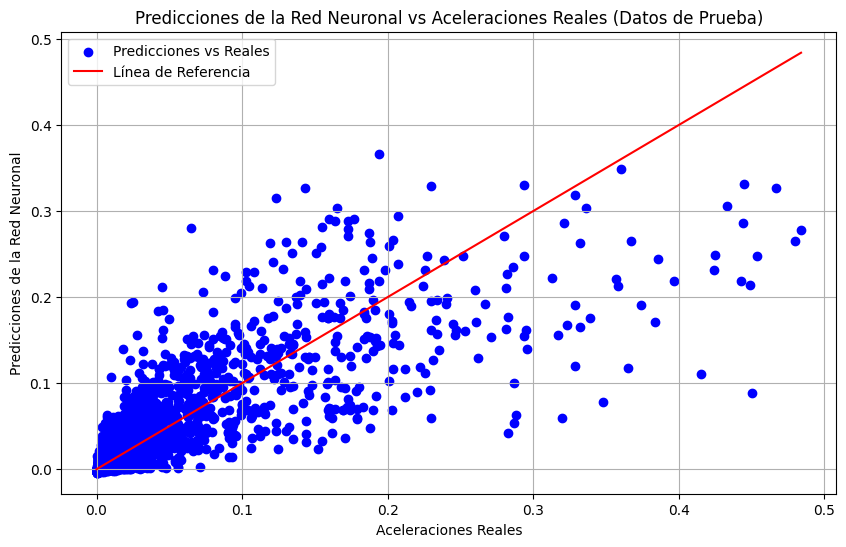

In [ ]:
import matplotlib.pyplot as plt

# Utiliza el modelo entrenado para predecir las aceleraciones utilizando los datos de prueba
y_pred = model.predict(X_test).flatten()

# Grafica las predicciones versus las aceleraciones reales
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', label='Predicciones vs Reales')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', label='Línea de Referencia')
plt.title('Predicciones de la Red Neuronal vs Aceleraciones Reales (Datos de Prueba)')
plt.xlabel('Aceleraciones Reales')
plt.ylabel('Predicciones de la Red Neuronal')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
# Predicciones de la red neuronal en el conjunto de prueba
predictions = model.predict(X_test).flatten()

# Agregar las predicciones como una nueva columna al conjunto de datos de prueba
df_test = pd.DataFrame(X_test, columns=df_selected.columns[:-1])  # Creamos un DataFrame con las características de prueba
df_test['PGA (g)'] = y_test  # Agregamos la variable original 'PGA (g)'
df_test['Predict RNA'] = predictions  # Agregamos las predicciones como una nueva columna


# Mostrar todo el dataset con las predicciones
print(df_test)

Se han truncado las últimas 5000 líneas del flujo de salida.
3482  -0.658281             -0.752263                      -0.769207   
3483  -0.969354             -0.966723                       1.556381   
3484  -0.940674             -0.172427                      -0.769207   
3485  -1.022038             -0.513974                      -0.769207   
3486  -0.570828              1.551195                       0.781185   
3487   0.381451              2.123088                       1.556381   
3488  -0.375801             -0.919065                       0.005989   
3489  -0.718907             -1.228840                       1.556381   
3490   0.357713             -0.196256                      -0.769207   
3491  -0.587772             -1.157353                      -0.769207   
3492  -0.845896             -0.664890                      -0.769207   
3493   0.604982             -0.990551                      -0.769207   
3494   1.992675              1.630624                      -0.769207   
349

In [ ]:
# Ajustar la configuración de visualización para mostrar todas las filas
pd.set_option('display.max_rows', None)
# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.971648              0.121463                       0.005989   
1      0.827013              1.320849                      -0.769207   
2      2.732984             -0.831692                       2.331577   
3     -0.991328             -0.196256                      -0.769207   
4      1.092991              1.471765                       0.781185   
5     -0.773003              0.995188                      -0.769207   
6     -0.378537              0.995188                       0.781185   
7     -0.743970             -0.752263                      -0.769207   
8      1.211772              1.789483                      -0.769207   
9      5.490455              2.345490                       1.556381   
10    -0.427338             -0.172427                      -0.769207   
11     0.291703             -1.038209                       1.556381   
12    -0.056433             -0.545746                      -0.76

In [ ]:
# Cargar el archivo CSV de validación
url_validacion = '/content/DATA_VALIDACION_200.csv'
df_validacion = pd.read_csv(url_validacion)

# Seleccionar solo las variables relevantes para la predicción
df_validacion_selected = df_validacion[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis', 'HypD (km)']]

# Escalar los datos de validación
X_validacion = scaler.transform(df_validacion_selected.values)

# Realizar las predicciones con el modelo de red neuronal
predictions_validacion = model.predict(X_validacion).flatten()

# Agregar las predicciones como una nueva columna al conjunto de datos de validación
df_validacion['Predict RNA'] = predictions_validacion

# Mostrar el conjunto de datos de validación con las predicciones
print(df_validacion)

7/7 [==============================] - 0s 2ms/step
     Earthquake Magnitude  Mechanism Based on Rake Angle  EpiD (km)  \
0                    4.11                              1     215.19   
1                    4.11                              1     136.41   
2                    4.11                              1     146.01   
3                    4.11                              1     149.06   
4                    4.11                              1     135.25   
5                    4.11                              1     217.00   
6                    4.11                              1      92.01   
7                    4.11                              1     101.28   
8                    4.11                              1     179.19   
9                    4.11                              1     120.89   
10                   4.11                              1     179.25   
11                   4.11                              1     174.66   
12                   4.11 

**MÉTRICAS DE EVALUACIÓN**

**R2**

In [ ]:
from sklearn.metrics import r2_score

# Calculamos el coeficiente de determinación R²
r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R²:', r2)

Coeficiente de determinación R²: 0.6862255441311926


**MSE**

In [ ]:
from sklearn.metrics import mean_squared_error

# Calculamos el Error Cuadrático Medio (MSE)
mse = mean_squared_error(y_test, y_pred)
print('Error Cuadrático Medio (MSE):', mse)

Error Cuadrático Medio (MSE): 0.0009402104357604902


**RMSE**

In [ ]:
import numpy as np

# Calculamos la Raíz del Error Cuadrático Medio (RMSE)
rmse = np.sqrt(mse)
print('Raíz del Error Cuadrático Medio (RMSE):', rmse)

Raíz del Error Cuadrático Medio (RMSE): 0.030662851070317812


**RMSLE**

In [ ]:
from sklearn.metrics import mean_squared_log_error
y_test_positive = y_test + 1
y_pred_positive = y_pred + 1

# Calculamos el Error Cuadrático Logarítmico Medio (RMSLE)
rmsle = np.sqrt(mean_squared_log_error(y_test_positive, y_pred_positive))
print('Root Mean Squared Logarithmic Error (RMSLE):', rmsle)

Root Mean Squared Logarithmic Error (RMSLE): 0.0141370806382296


**MAE**

In [ ]:
from sklearn.metrics import mean_absolute_error

# Calculamos el Error Absoluto Medio (MAE)
mae = mean_absolute_error(y_test, y_pred)
print('Error Absoluto Medio (MAE):', mae)

Error Absoluto Medio (MAE): 0.012969498863324243


**LIBRERÍA PYTORCH**

**Función de activación ReLU - 1 capa de entrada de 5 neuronas y 3 capas ocultas - 100 épocas - 80% entrenamiento - 20% prueba.**

In [ ]:
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score

# Cargamos el archivo CSV
url = '/content/DATA_PGA_050.csv'  # Ruta del archivo CSV
df = pd.read_csv(url)

# Seleccionamos solo las variables relevantes
df_selected = df[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis','HypD (km)', 'PGA (g)']]

# Dividimos los datos en características (X) y etiquetas (y)
X = df_selected.drop('PGA (g)', axis=1).values
y = df_selected['PGA (g)'].values

# Dividimos los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Escalamos los datos
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Convertimos los datos a tensores de PyTorch
X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train, dtype=torch.float32)
X_test_tensor = torch.tensor(X_test, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test, dtype=torch.float32)

# Definimos el modelo de red neuronal con PyTorch
class NeuralNetwork(nn.Module):
    def __init__(self, input_size):
        super(NeuralNetwork, self).__init__()
        self.fc1 = nn.Linear(input_size, 64)
        self.fc2 = nn.Linear(64, 32)
        self.fc3 = nn.Linear(32, 16)
        self.fc4 = nn.Linear(16, 1)
        self.relu = nn.ReLU()

    def forward(self, x):
        x = self.relu(self.fc1(x))
        x = self.relu(self.fc2(x))
        x = self.relu(self.fc3(x))
        x = self.fc4(x)
        return x

# Inicializamos el modelo
model = NeuralNetwork(X_train.shape[1])

# Definimos la función de pérdida y el optimizador
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Entrenamos el modelo
batch_size = 64
epochs = 100
for epoch in range(epochs):
    for i in range(0, len(X_train_tensor), batch_size):
        inputs = X_train_tensor[i:i+batch_size]
        labels = y_train_tensor[i:i+batch_size]

        # Forward pass
        outputs = model(inputs)
        loss = criterion(outputs, labels.view(-1, 1))

        # Backward pass y optimización
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    # Imprimir el progreso
    if (epoch+1) % 10 == 0:
        print(f'Epoch [{epoch+1}/{epochs}], Loss: {loss.item():.4f}')

# Evaluamos el modelo en el conjunto de prueba
with torch.no_grad():
    y_pred_tensor = model(X_test_tensor)
    mse = criterion(y_pred_tensor, y_test_tensor.view(-1, 1))
    print('Mean Squared Error on Test Set:', mse.item())

    # Convertimos las predicciones y etiquetas a arrays de numpy
    y_pred = y_pred_tensor.numpy().flatten()
    y_test = y_test_tensor.numpy()

    # Calculamos el coeficiente de determinación R² (R cuadrado)
    r2 = r2_score(y_test, y_pred)
    print('Coeficiente de determinación R²:', r2)

# Guardamos el modelo (esto es opcional en PyTorch)
torch.save(model.state_dict(), 'modelo.pth')


Epoch [10/100], Loss: 0.0006
Epoch [20/100], Loss: 0.0005
Epoch [30/100], Loss: 0.0005
Epoch [40/100], Loss: 0.0006
Epoch [50/100], Loss: 0.0006
Epoch [60/100], Loss: 0.0006
Epoch [70/100], Loss: 0.0005
Epoch [80/100], Loss: 0.0005
Epoch [90/100], Loss: 0.0005
Epoch [100/100], Loss: 0.0005
Mean Squared Error on Test Set: 0.0008727088570594788
Coeficiente de determinación R²: 0.7087527125529642


**Matriz de Correlación**

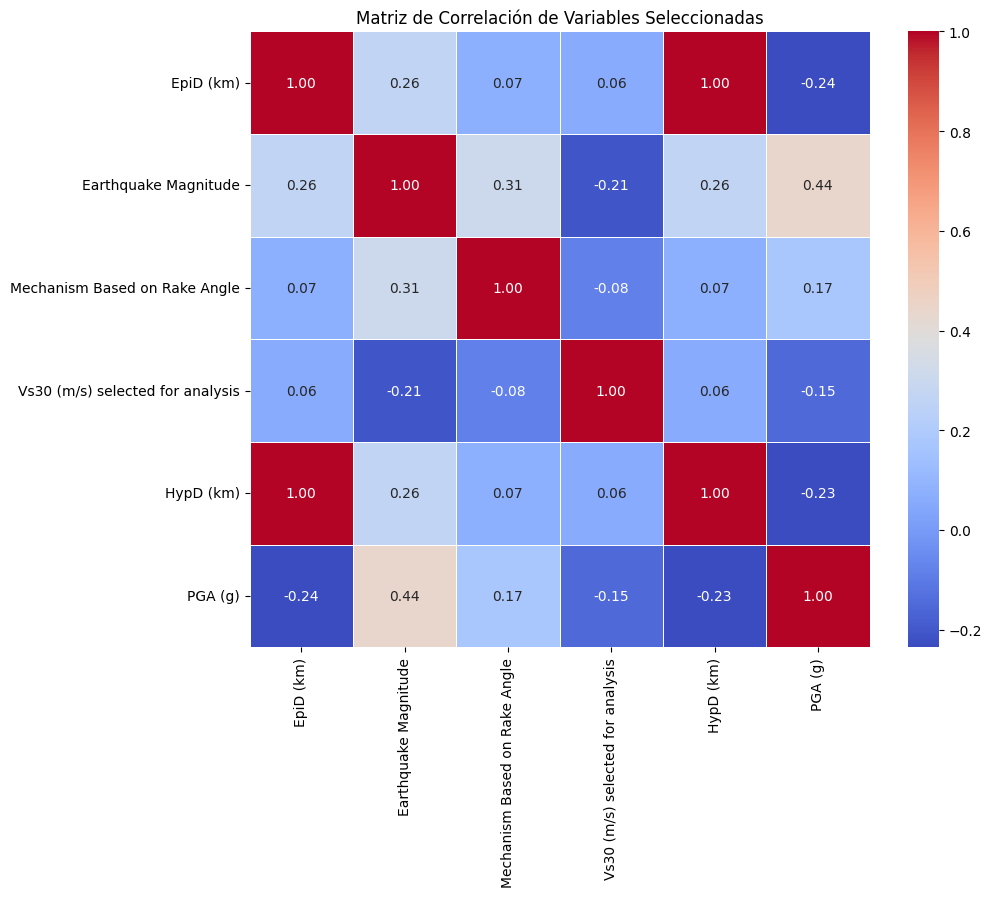

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Cargamos el archivo CSV
url = '/content/DATA_PGA_050.csv'  # Ruta del archivo CSV
df = pd.read_csv(url)

# Seleccionamos solo las variables relevantes
df_selected = df[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis','HypD (km)', 'PGA (g)']]

# Calculamos la matriz de correlación
correlation_matrix = df_selected.corr()

# Creamos un mapa de calor para visualizar la matriz de correlación
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Matriz de Correlación de Variables Seleccionadas')
plt.show()

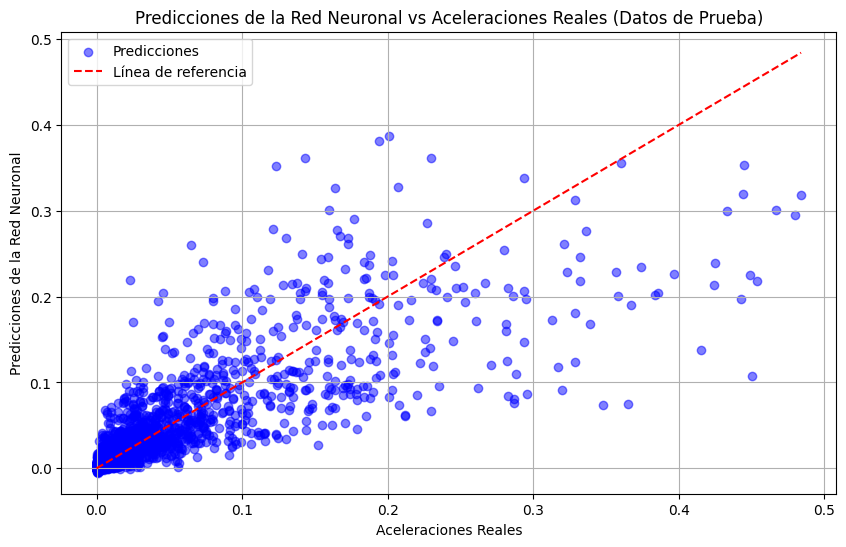

In [ ]:
import matplotlib.pyplot as plt

# Graficamos las predicciones vs las aceleraciones reales
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', alpha=0.5, label='Predicciones')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], linestyle='--', color='red', label='Línea de referencia')  # Línea de referencia (y_test = y_pred)
plt.title('Predicciones de la Red Neuronal vs Aceleraciones Reales (Datos de Prueba)')
plt.xlabel('Aceleraciones Reales')
plt.ylabel('Predicciones de la Red Neuronal')
plt.grid(True)
plt.legend()
plt.show()

In [ ]:
import pandas as pd
import torch

# Convertimos los datos de prueba a tensores de PyTorch
X_test_tensor = torch.tensor(X_test, dtype=torch.float32)

# Predicciones de la red neuronal en el conjunto de prueba
with torch.no_grad():
    predictions_tensor = model(X_test_tensor)
    predictions = predictions_tensor.numpy().flatten()

# Agregar las predicciones como una nueva columna al conjunto de datos de prueba
df_test = pd.DataFrame(X_test, columns=df_selected.columns[:-1])  # Creamos un DataFrame con las características de prueba
df_test['PGA (g)'] = y_test  # Agregamos la variable original 'PGA (g)'
df_test['Predict RNA'] = predictions  # Agregamos las predicciones como una nueva columna

# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.971648              0.121463                       0.005989   
1      0.827013              1.320849                      -0.769207   
2      2.732984             -0.831692                       2.331577   
3     -0.991328             -0.196256                      -0.769207   
4      1.092991              1.471765                       0.781185   
5     -0.773003              0.995188                      -0.769207   
6     -0.378537              0.995188                       0.781185   
7     -0.743970             -0.752263                      -0.769207   
8      1.211772              1.789483                      -0.769207   
9      5.490455              2.345490                       1.556381   
10    -0.427338             -0.172427                      -0.769207   
11     0.291703             -1.038209                       1.556381   
12    -0.056433             -0.545746                      -0.76

In [ ]:
# Ajustar la configuración de visualización para mostrar todas las filas
pd.set_option('display.max_rows', None)
# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.971648              0.121463                       0.005989   
1      0.827013              1.320849                      -0.769207   
2      2.732984             -0.831692                       2.331577   
3     -0.991328             -0.196256                      -0.769207   
4      1.092991              1.471765                       0.781185   
5     -0.773003              0.995188                      -0.769207   
6     -0.378537              0.995188                       0.781185   
7     -0.743970             -0.752263                      -0.769207   
8      1.211772              1.789483                      -0.769207   
9      5.490455              2.345490                       1.556381   
10    -0.427338             -0.172427                      -0.769207   
11     0.291703             -1.038209                       1.556381   
12    -0.056433             -0.545746                      -0.76

In [ ]:
import pandas as pd

# Cargamos el archivo CSV de validación
url_validacion = '/content/DATA_VALIDACION_200.csv'
df_validacion = pd.read_csv(url_validacion)

# Seleccionamos solo las características relevantes del DataFrame de validación
df_validacion_selected = df_validacion[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis', 'HypD (km)']]

# Convertimos los datos de validación seleccionados a tensores de PyTorch
X_validacion_tensor = torch.tensor(df_validacion_selected.values, dtype=torch.float32)

# Predicciones de la red neuronal en el conjunto de validación
with torch.no_grad():
    predictions_validacion_tensor = model(X_validacion_tensor)
    predictions_validacion = predictions_validacion_tensor.numpy().flatten()

# Agregamos las predicciones como una nueva columna al DataFrame de validación
df_validacion['Predict RNA'] = predictions_validacion

# Mostramos el DataFrame con las predicciones
print(df_validacion)

     Earthquake Magnitude  Mechanism Based on Rake Angle  EpiD (km)  \
0                    4.11                              1     215.19   
1                    4.11                              1     136.41   
2                    4.11                              1     146.01   
3                    4.11                              1     149.06   
4                    4.11                              1     135.25   
5                    4.11                              1     217.00   
6                    4.11                              1      92.01   
7                    4.11                              1     101.28   
8                    4.11                              1     179.19   
9                    4.11                              1     120.89   
10                   4.11                              1     179.25   
11                   4.11                              1     174.66   
12                   4.11                              1     120.87   
13    

**MÉTRICAS DE EVALUACIÓN**

**R2**

In [ ]:
from sklearn.metrics import r2_score

# Calculamos el coeficiente de determinación R²
r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R²:', r2)

Coeficiente de determinación R²: 0.7037462442340107


**MSE**

In [ ]:
from sklearn.metrics import mean_squared_error

# Calculamos el Error Cuadrático Medio (MSE)
mse = mean_squared_error(y_test, y_pred)
print('Error Cuadrático Medio (MSE):', mse)

Error Cuadrático Medio (MSE): 0.0008877104


**RMSE**

In [ ]:
import numpy as np

# Calculamos la Raíz del Error Cuadrático Medio (RMSE)
rmse = np.sqrt(mse)
print('Raíz del Error Cuadrático Medio (RMSE):', rmse)

Raíz del Error Cuadrático Medio (RMSE): 0.02979447


**RMSLE**

In [ ]:
from sklearn.metrics import mean_squared_log_error
y_test_positive = y_test + 1
y_pred_positive = y_pred + 1

# Calculamos el Error Cuadrático Logarítmico Medio (RMSLE)
rmsle = np.sqrt(mean_squared_log_error(y_test_positive, y_pred_positive))
print('Root Mean Squared Logarithmic Error (RMSLE):', rmsle)

Root Mean Squared Logarithmic Error (RMSLE): 0.013680939


**MAE**

In [ ]:
from sklearn.metrics import mean_absolute_error

# Calculamos el Error Absoluto Medio (MAE)
mae = mean_absolute_error(y_test, y_pred)
print('Error Absoluto Medio (MAE):', mae)

Error Absoluto Medio (MAE): 0.011885881


**Función de activación ReLU - 1 capa de entrada de 5 neuronas y 3 capas ocultas - 100 épocas - 70% entrenamiento - 30% prueba.**

In [ ]:
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score

# Cargamos el archivo CSV
url = '/content/DATA_PGA_050.csv'  # Ruta del archivo CSV
df = pd.read_csv(url)

# Seleccionamos solo las variables relevantes
df_selected = df[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis','HypD (km)', 'PGA (g)']]

# Dividimos los datos en características (X) y etiquetas (y)
X = df_selected.drop('PGA (g)', axis=1).values
y = df_selected['PGA (g)'].values

# Dividimos los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Escalamos los datos
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Convertimos los datos a tensores de PyTorch
X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train, dtype=torch.float32)
X_test_tensor = torch.tensor(X_test, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test, dtype=torch.float32)

# Definimos el modelo de red neuronal con PyTorch
class NeuralNetwork(nn.Module):
    def __init__(self, input_size):
        super(NeuralNetwork, self).__init__()
        self.fc1 = nn.Linear(input_size, 64)
        self.fc2 = nn.Linear(64, 32)
        self.fc3 = nn.Linear(32, 16)
        self.fc4 = nn.Linear(16, 1)
        self.relu = nn.ReLU()

    def forward(self, x):
        x = self.relu(self.fc1(x))
        x = self.relu(self.fc2(x))
        x = self.relu(self.fc3(x))
        x = self.fc4(x)
        return x

# Inicializamos el modelo
model = NeuralNetwork(X_train.shape[1])

# Definimos la función de pérdida y el optimizador
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Entrenamos el modelo
batch_size = 64
epochs = 100
for epoch in range(epochs):
    for i in range(0, len(X_train_tensor), batch_size):
        inputs = X_train_tensor[i:i+batch_size]
        labels = y_train_tensor[i:i+batch_size]

        # Forward pass
        outputs = model(inputs)
        loss = criterion(outputs, labels.view(-1, 1))

        # Backward pass y optimización
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    # Imprimir el progreso
    if (epoch+1) % 10 == 0:
        print(f'Epoch [{epoch+1}/{epochs}], Loss: {loss.item():.4f}')

# Evaluamos el modelo en el conjunto de prueba
with torch.no_grad():
    y_pred_tensor = model(X_test_tensor)
    mse = criterion(y_pred_tensor, y_test_tensor.view(-1, 1))
    print('Mean Squared Error on Test Set:', mse.item())

    # Convertimos las predicciones y etiquetas a arrays de numpy
    y_pred = y_pred_tensor.numpy().flatten()
    y_test = y_test_tensor.numpy()

    # Calculamos el coeficiente de determinación R² (R cuadrado)
    r2 = r2_score(y_test, y_pred)
    print('Coeficiente de determinación R²:', r2)

# Guardamos el modelo (esto es opcional en PyTorch)
torch.save(model.state_dict(), 'modelo.pth')

Epoch [10/100], Loss: 0.0007
Epoch [20/100], Loss: 0.0006
Epoch [30/100], Loss: 0.0006
Epoch [40/100], Loss: 0.0006
Epoch [50/100], Loss: 0.0005
Epoch [60/100], Loss: 0.0004
Epoch [70/100], Loss: 0.0005
Epoch [80/100], Loss: 0.0004
Epoch [90/100], Loss: 0.0004
Epoch [100/100], Loss: 0.0004
Mean Squared Error on Test Set: 0.0008808256825432181
Coeficiente de determinación R²: 0.7146228366241074


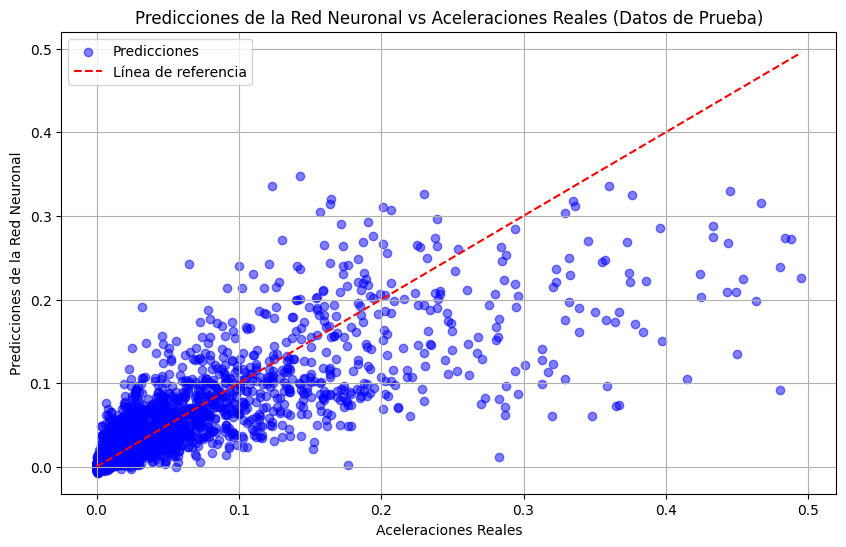

In [ ]:
import matplotlib.pyplot as plt

# Graficamos las predicciones vs las aceleraciones reales
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', alpha=0.5, label='Predicciones')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], linestyle='--', color='red', label='Línea de referencia')  # Línea de referencia (y_test = y_pred)
plt.title('Predicciones de la Red Neuronal vs Aceleraciones Reales (Datos de Prueba)')
plt.xlabel('Aceleraciones Reales')
plt.ylabel('Predicciones de la Red Neuronal')
plt.grid(True)
plt.legend()
plt.show()

In [ ]:
import pandas as pd
import torch

# Convertimos los datos de prueba a tensores de PyTorch
X_test_tensor = torch.tensor(X_test, dtype=torch.float32)

# Predicciones de la red neuronal en el conjunto de prueba
with torch.no_grad():
    predictions_tensor = model(X_test_tensor)
    predictions = predictions_tensor.numpy().flatten()

# Agregar las predicciones como una nueva columna al conjunto de datos de prueba
df_test = pd.DataFrame(X_test, columns=df_selected.columns[:-1])  # Creamos un DataFrame con las características de prueba
df_test['PGA (g)'] = y_test  # Agregamos la variable original 'PGA (g)'
df_test['Predict RNA'] = predictions  # Agregamos las predicciones como una nueva columna

# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.958670              0.121924                       0.004438   
1      0.819170              1.320204                      -0.770187   
2      2.703078             -0.830352                       2.328313   
3     -0.978122             -0.195501                      -0.770187   
4      1.082070              1.470981                       0.779063   
5     -0.762324              0.994843                      -0.770187   
6     -0.372424              0.994843                       0.779063   
7     -0.733627             -0.750995                      -0.770187   
8      1.199476              1.788406                      -0.770187   
9      5.428629              2.343900                       1.553688   
10    -0.420660             -0.171695                      -0.770187   
11     0.290057             -1.036678                       1.553688   
12    -0.054049             -0.544669                      -0.77

In [ ]:
# Ajustar la configuración de visualización para mostrar todas las filas
pd.set_option('display.max_rows', None)
# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.958670              0.121924                       0.004438   
1      0.819170              1.320204                      -0.770187   
2      2.703078             -0.830352                       2.328313   
3     -0.978122             -0.195501                      -0.770187   
4      1.082070              1.470981                       0.779063   
5     -0.762324              0.994843                      -0.770187   
6     -0.372424              0.994843                       0.779063   
7     -0.733627             -0.750995                      -0.770187   
8      1.199476              1.788406                      -0.770187   
9      5.428629              2.343900                       1.553688   
10    -0.420660             -0.171695                      -0.770187   
11     0.290057             -1.036678                       1.553688   
12    -0.054049             -0.544669                      -0.77

In [ ]:
import pandas as pd

# Cargamos el archivo CSV de validación
url_validacion = '/content/DATA_VALIDACION_200.csv'
df_validacion = pd.read_csv(url_validacion)

# Seleccionamos solo las características relevantes del DataFrame de validación
df_validacion_selected = df_validacion[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis', 'HypD (km)']]

# Convertimos los datos de validación seleccionados a tensores de PyTorch
X_validacion_tensor = torch.tensor(df_validacion_selected.values, dtype=torch.float32)

# Predicciones de la red neuronal en el conjunto de validación
with torch.no_grad():
    predictions_validacion_tensor = model(X_validacion_tensor)
    predictions_validacion = predictions_validacion_tensor.numpy().flatten()

# Agregamos las predicciones como una nueva columna al DataFrame de validación
df_validacion['Predict RNA'] = predictions_validacion

# Mostramos el DataFrame con las predicciones
print(df_validacion)

     Earthquake Magnitude  Mechanism Based on Rake Angle  EpiD (km)  \
0                    4.11                              1     215.19   
1                    4.11                              1     136.41   
2                    4.11                              1     146.01   
3                    4.11                              1     149.06   
4                    4.11                              1     135.25   
5                    4.11                              1     217.00   
6                    4.11                              1      92.01   
7                    4.11                              1     101.28   
8                    4.11                              1     179.19   
9                    4.11                              1     120.89   
10                   4.11                              1     179.25   
11                   4.11                              1     174.66   
12                   4.11                              1     120.87   
13    

**MÉTRICAS DE EVALUACIÓN**

**R2**

In [ ]:
from sklearn.metrics import r2_score

# Calculamos el coeficiente de determinación R²
r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R²:', r2)

Coeficiente de determinación R²: 0.7146228366241074


**MSE**

In [ ]:
from sklearn.metrics import mean_squared_error

# Calculamos el Error Cuadrático Medio (MSE)
mse = mean_squared_error(y_test, y_pred)
print('Error Cuadrático Medio (MSE):', mse)

Error Cuadrático Medio (MSE): 0.00088082557


**RMSE**

In [ ]:
import numpy as np

# Calculamos la Raíz del Error Cuadrático Medio (RMSE)
rmse = np.sqrt(mse)
print('Raíz del Error Cuadrático Medio (RMSE):', rmse)

Raíz del Error Cuadrático Medio (RMSE): 0.029678706


**RMSLE**

In [ ]:
from sklearn.metrics import mean_squared_log_error
y_test_positive = y_test + 1
y_pred_positive = y_pred + 1

# Calculamos el Error Cuadrático Logarítmico Medio (RMSLE)
rmsle = np.sqrt(mean_squared_log_error(y_test_positive, y_pred_positive))
print('Root Mean Squared Logarithmic Error (RMSLE):', rmsle)

Root Mean Squared Logarithmic Error (RMSLE): 0.013598331


**MAE**

In [ ]:
from sklearn.metrics import mean_absolute_error

# Calculamos el Error Absoluto Medio (MAE)
mae = mean_absolute_error(y_test, y_pred)
print('Error Absoluto Medio (MAE):', mae)

Error Absoluto Medio (MAE): 0.011288733


**Función de activación ReLU - 1 capa de entrada de 5 neuronas y 3 capas ocultas - 100 épocas - 90% entrenamiento - 10% prueba.**

In [ ]:
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score

# Cargamos el archivo CSV
url = '/content/DATA_PGA_050.csv'  # Ruta del archivo CSV
df = pd.read_csv(url)

# Seleccionamos solo las variables relevantes
df_selected = df[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis','HypD (km)', 'PGA (g)']]

# Dividimos los datos en características (X) y etiquetas (y)
X = df_selected.drop('PGA (g)', axis=1).values
y = df_selected['PGA (g)'].values

# Dividimos los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42)

# Escalamos los datos
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Convertimos los datos a tensores de PyTorch
X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train, dtype=torch.float32)
X_test_tensor = torch.tensor(X_test, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test, dtype=torch.float32)

# Definimos el modelo de red neuronal con PyTorch
class NeuralNetwork(nn.Module):
    def __init__(self, input_size):
        super(NeuralNetwork, self).__init__()
        self.fc1 = nn.Linear(input_size, 64)
        self.fc2 = nn.Linear(64, 32)
        self.fc3 = nn.Linear(32, 16)
        self.fc4 = nn.Linear(16, 1)
        self.relu = nn.ReLU()

    def forward(self, x):
        x = self.relu(self.fc1(x))
        x = self.relu(self.fc2(x))
        x = self.relu(self.fc3(x))
        x = self.fc4(x)
        return x

# Inicializamos el modelo
model = NeuralNetwork(X_train.shape[1])

# Definimos la función de pérdida y el optimizador
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Entrenamos el modelo
batch_size = 64
epochs = 100
for epoch in range(epochs):
    for i in range(0, len(X_train_tensor), batch_size):
        inputs = X_train_tensor[i:i+batch_size]
        labels = y_train_tensor[i:i+batch_size]

        # Forward pass
        outputs = model(inputs)
        loss = criterion(outputs, labels.view(-1, 1))

        # Backward pass y optimización
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    # Imprimir el progreso
    if (epoch+1) % 10 == 0:
        print(f'Epoch [{epoch+1}/{epochs}], Loss: {loss.item():.4f}')

# Evaluamos el modelo en el conjunto de prueba
with torch.no_grad():
    y_pred_tensor = model(X_test_tensor)
    mse = criterion(y_pred_tensor, y_test_tensor.view(-1, 1))
    print('Mean Squared Error on Test Set:', mse.item())

    # Convertimos las predicciones y etiquetas a arrays de numpy
    y_pred = y_pred_tensor.numpy().flatten()
    y_test = y_test_tensor.numpy()

    # Calculamos el coeficiente de determinación R² (R cuadrado)
    r2 = r2_score(y_test, y_pred)
    print('Coeficiente de determinación R²:', r2)

# Guardamos el modelo (esto es opcional en PyTorch)
torch.save(model.state_dict(), 'modelo.pth')

Epoch [10/100], Loss: 0.0000
Epoch [20/100], Loss: 0.0000
Epoch [30/100], Loss: 0.0000
Epoch [40/100], Loss: 0.0000
Epoch [50/100], Loss: 0.0000
Epoch [60/100], Loss: 0.0000
Epoch [70/100], Loss: 0.0000
Epoch [80/100], Loss: 0.0000
Epoch [90/100], Loss: 0.0000
Epoch [100/100], Loss: 0.0000
Mean Squared Error on Test Set: 0.0008838001522235572
Coeficiente de determinación R²: 0.7136139562951662


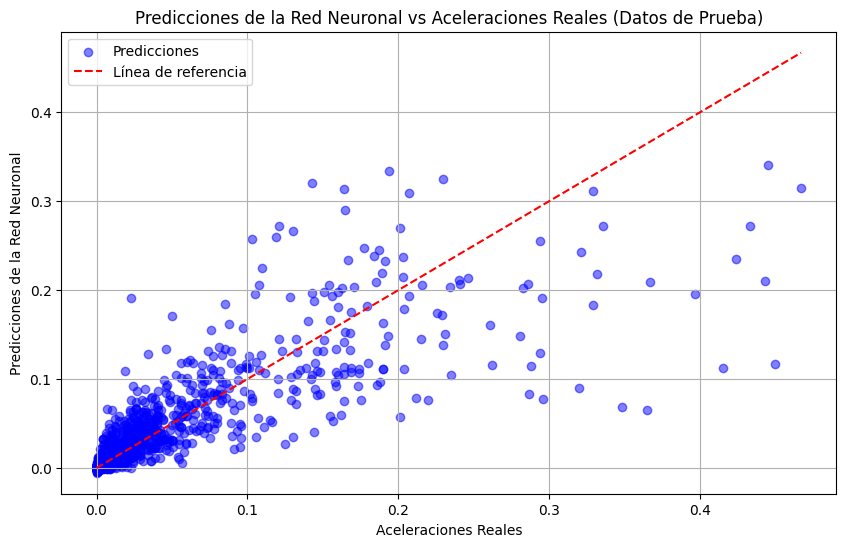

In [ ]:
import matplotlib.pyplot as plt

# Graficamos las predicciones vs las aceleraciones reales
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', alpha=0.5, label='Predicciones')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], linestyle='--', color='red', label='Línea de referencia')  # Línea de referencia (y_test = y_pred)
plt.title('Predicciones de la Red Neuronal vs Aceleraciones Reales (Datos de Prueba)')
plt.xlabel('Aceleraciones Reales')
plt.ylabel('Predicciones de la Red Neuronal')
plt.grid(True)
plt.legend()
plt.show()

In [ ]:
import pandas as pd
import torch

# Convertimos los datos de prueba a tensores de PyTorch
X_test_tensor = torch.tensor(X_test, dtype=torch.float32)

# Predicciones de la red neuronal en el conjunto de prueba
with torch.no_grad():
    predictions_tensor = model(X_test_tensor)
    predictions = predictions_tensor.numpy().flatten()

# Agregar las predicciones como una nueva columna al conjunto de datos de prueba
df_test = pd.DataFrame(X_test, columns=df_selected.columns[:-1])  # Creamos un DataFrame con las características de prueba
df_test['PGA (g)'] = y_test  # Agregamos la variable original 'PGA (g)'
df_test['Predict RNA'] = predictions  # Agregamos las predicciones como una nueva columna

# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.968945              0.122893                       0.005614   
1      0.825426              1.321808                      -0.770449   
2      2.726850             -0.829887                       2.333802   
3     -0.988577             -0.194700                      -0.770449   
4      1.090769              1.472665                       0.781676   
5     -0.770774              0.996275                      -0.770449   
6     -0.377248              0.996275                       0.781676   
7     -0.741810             -0.750488                      -0.770449   
8      1.209267              1.790258                      -0.770449   
9      5.477743              2.346047                       1.557739   
10    -0.425933             -0.170881                      -0.770449   
11     0.291393             -1.036323                       1.557739   
12    -0.055913             -0.544053                      -0.77

In [ ]:
# Ajustar la configuración de visualización para mostrar todas las filas
pd.set_option('display.max_rows', None)
# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.968945              0.122893                       0.005614   
1      0.825426              1.321808                      -0.770449   
2      2.726850             -0.829887                       2.333802   
3     -0.988577             -0.194700                      -0.770449   
4      1.090769              1.472665                       0.781676   
5     -0.770774              0.996275                      -0.770449   
6     -0.377248              0.996275                       0.781676   
7     -0.741810             -0.750488                      -0.770449   
8      1.209267              1.790258                      -0.770449   
9      5.477743              2.346047                       1.557739   
10    -0.425933             -0.170881                      -0.770449   
11     0.291393             -1.036323                       1.557739   
12    -0.055913             -0.544053                      -0.77

In [ ]:
import pandas as pd

# Cargamos el archivo CSV de validación
url_validacion = '/content/DATA_VALIDACION_200.csv'
df_validacion = pd.read_csv(url_validacion)

# Seleccionamos solo las características relevantes del DataFrame de validación
df_validacion_selected = df_validacion[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis', 'HypD (km)']]

# Convertimos los datos de validación seleccionados a tensores de PyTorch
X_validacion_tensor = torch.tensor(df_validacion_selected.values, dtype=torch.float32)

# Predicciones de la red neuronal en el conjunto de validación
with torch.no_grad():
    predictions_validacion_tensor = model(X_validacion_tensor)
    predictions_validacion = predictions_validacion_tensor.numpy().flatten()

# Agregamos las predicciones como una nueva columna al DataFrame de validación
df_validacion['Predict RNA'] = predictions_validacion

# Mostramos el DataFrame con las predicciones
print(df_validacion)

     Earthquake Magnitude  Mechanism Based on Rake Angle  EpiD (km)  \
0                    4.11                              1     215.19   
1                    4.11                              1     136.41   
2                    4.11                              1     146.01   
3                    4.11                              1     149.06   
4                    4.11                              1     135.25   
5                    4.11                              1     217.00   
6                    4.11                              1      92.01   
7                    4.11                              1     101.28   
8                    4.11                              1     179.19   
9                    4.11                              1     120.89   
10                   4.11                              1     179.25   
11                   4.11                              1     174.66   
12                   4.11                              1     120.87   
13    

**MÉTRICAS DE EVALUACIÓN**

**R2**

In [ ]:
from sklearn.metrics import r2_score

# Calculamos el coeficiente de determinación R²
r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R²:', r2)

Coeficiente de determinación R²: 0.7136139562951662


**MSE**

In [ ]:
from sklearn.metrics import mean_squared_error

# Calculamos el Error Cuadrático Medio (MSE)
mse = mean_squared_error(y_test, y_pred)
print('Error Cuadrático Medio (MSE):', mse)

Error Cuadrático Medio (MSE): 0.00088380004


**RMSE**

In [ ]:
import numpy as np

# Calculamos la Raíz del Error Cuadrático Medio (RMSE)
rmse = np.sqrt(mse)
print('Raíz del Error Cuadrático Medio (RMSE):', rmse)

Raíz del Error Cuadrático Medio (RMSE): 0.029728774


**RMSLE**

In [ ]:
from sklearn.metrics import mean_squared_log_error
y_test_positive = y_test + 1
y_pred_positive = y_pred + 1

# Calculamos el Error Cuadrático Logarítmico Medio (RMSLE)
rmsle = np.sqrt(mean_squared_log_error(y_test_positive, y_pred_positive))
print('Root Mean Squared Logarithmic Error (RMSLE):', rmsle)

Root Mean Squared Logarithmic Error (RMSLE): 0.013620938


**MAE**

In [ ]:
from sklearn.metrics import mean_absolute_error

# Calculamos el Error Absoluto Medio (MAE)
mae = mean_absolute_error(y_test, y_pred)
print('Error Absoluto Medio (MAE):', mae)

Error Absoluto Medio (MAE): 0.011475127


**Función de activación Tangente Hipérbolica - 1 capa de entrada de 5 neuronas y 3 capas ocultas - 100 épocas - 80% entrenamiento - 20% prueba.**

In [ ]:
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score

# Cargamos el archivo CSV
url = '/content/DATA_PGA_050.csv'  # Ruta del archivo CSV
df = pd.read_csv(url)

# Seleccionamos solo las variables relevantes
df_selected = df[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis','HypD (km)', 'PGA (g)']]

# Dividimos los datos en características (X) y etiquetas (y)
X = df_selected.drop('PGA (g)', axis=1).values
y = df_selected['PGA (g)'].values

# Dividimos los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Escalamos los datos
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Convertimos los datos a tensores de PyTorch
X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train, dtype=torch.float32)
X_test_tensor = torch.tensor(X_test, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test, dtype=torch.float32)

# Definimos el modelo de red neuronal con PyTorch
class NeuralNetwork(nn.Module):
    def __init__(self, input_size):
        super(NeuralNetwork, self).__init__()
        self.fc1 = nn.Linear(input_size, 64)
        self.fc2 = nn.Linear(64, 32)
        self.fc3 = nn.Linear(32, 16)
        self.fc4 = nn.Linear(16, 1)
        self.tanh = nn.Tanh()

    def forward(self, x):
        x = self.tanh(self.fc1(x))
        x = self.tanh(self.fc2(x))
        x = self.tanh(self.fc3(x))
        x = self.fc4(x)
        return x

# Inicializamos el modelo
model = NeuralNetwork(X_train.shape[1])

# Definimos la función de pérdida y el optimizador
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Entrenamos el modelo
batch_size = 64
epochs = 100
for epoch in range(epochs):
    for i in range(0, len(X_train_tensor), batch_size):
        inputs = X_train_tensor[i:i+batch_size]
        labels = y_train_tensor[i:i+batch_size]

        # Forward pass
        outputs = model(inputs)
        loss = criterion(outputs, labels.view(-1, 1))

        # Backward pass y optimización
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    # Imprimir el progreso
    if (epoch+1) % 10 == 0:
        print(f'Epoch [{epoch+1}/{epochs}], Loss: {loss.item():.4f}')

# Evaluamos el modelo en el conjunto de prueba
with torch.no_grad():
    y_pred_tensor = model(X_test_tensor)
    mse = criterion(y_pred_tensor, y_test_tensor.view(-1, 1))
    print('Mean Squared Error on Test Set:', mse.item())

    # Convertimos las predicciones y etiquetas a arrays de numpy
    y_pred = y_pred_tensor.numpy().flatten()
    y_test = y_test_tensor.numpy()

    # Calculamos el coeficiente de determinación R² (R cuadrado)
    r2 = r2_score(y_test, y_pred)
    print('Coeficiente de determinación R²:', r2)

# Guardamos el modelo (esto es opcional en PyTorch)
torch.save(model.state_dict(), 'modelo.pth')


Epoch [10/100], Loss: 0.0006
Epoch [20/100], Loss: 0.0005
Epoch [30/100], Loss: 0.0005
Epoch [40/100], Loss: 0.0005
Epoch [50/100], Loss: 0.0005
Epoch [60/100], Loss: 0.0005
Epoch [70/100], Loss: 0.0005
Epoch [80/100], Loss: 0.0005
Epoch [90/100], Loss: 0.0005
Epoch [100/100], Loss: 0.0005
Mean Squared Error on Test Set: 0.0008764929370954633
Coeficiente de determinación R²: 0.7074898472640792


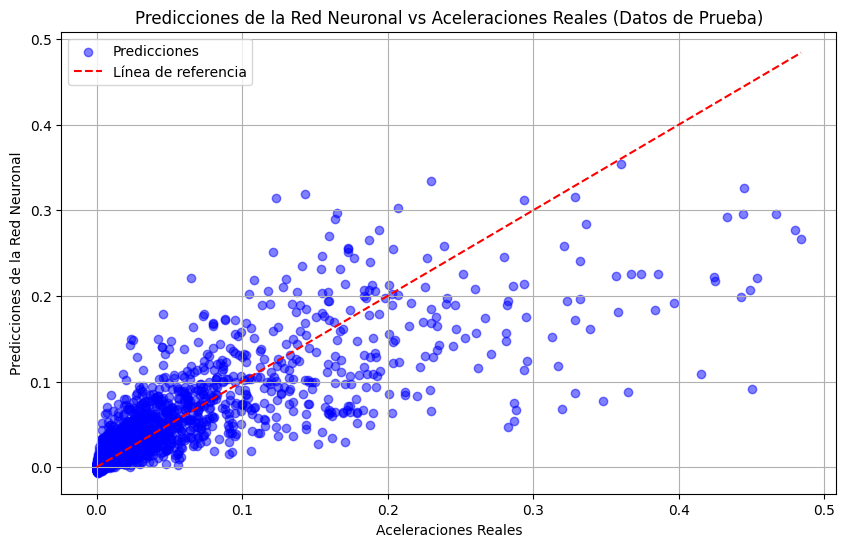

In [ ]:
import matplotlib.pyplot as plt

# Graficamos las predicciones vs las aceleraciones reales
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', alpha=0.5, label='Predicciones')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], linestyle='--', color='red', label='Línea de referencia')  # Línea de referencia (y_test = y_pred)
plt.title('Predicciones de la Red Neuronal vs Aceleraciones Reales (Datos de Prueba)')
plt.xlabel('Aceleraciones Reales')
plt.ylabel('Predicciones de la Red Neuronal')
plt.grid(True)
plt.legend()
plt.show()

In [ ]:
import pandas as pd
import torch

# Convertimos los datos de prueba a tensores de PyTorch
X_test_tensor = torch.tensor(X_test, dtype=torch.float32)

# Predicciones de la red neuronal en el conjunto de prueba
with torch.no_grad():
    predictions_tensor = model(X_test_tensor)
    predictions = predictions_tensor.numpy().flatten()

# Agregar las predicciones como una nueva columna al conjunto de datos de prueba
df_test = pd.DataFrame(X_test, columns=df_selected.columns[:-1])  # Creamos un DataFrame con las características de prueba
df_test['PGA (g)'] = y_test  # Agregamos la variable original 'PGA (g)'
df_test['Predict RNA'] = predictions  # Agregamos las predicciones como una nueva columna

# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.971648              0.121463                       0.005989   
1      0.827013              1.320849                      -0.769207   
2      2.732984             -0.831692                       2.331577   
3     -0.991328             -0.196256                      -0.769207   
4      1.092991              1.471765                       0.781185   
5     -0.773003              0.995188                      -0.769207   
6     -0.378537              0.995188                       0.781185   
7     -0.743970             -0.752263                      -0.769207   
8      1.211772              1.789483                      -0.769207   
9      5.490455              2.345490                       1.556381   
10    -0.427338             -0.172427                      -0.769207   
11     0.291703             -1.038209                       1.556381   
12    -0.056433             -0.545746                      -0.76

In [ ]:
# Ajustar la configuración de visualización para mostrar todas las filas
pd.set_option('display.max_rows', None)
# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.971648              0.121463                       0.005989   
1      0.827013              1.320849                      -0.769207   
2      2.732984             -0.831692                       2.331577   
3     -0.991328             -0.196256                      -0.769207   
4      1.092991              1.471765                       0.781185   
5     -0.773003              0.995188                      -0.769207   
6     -0.378537              0.995188                       0.781185   
7     -0.743970             -0.752263                      -0.769207   
8      1.211772              1.789483                      -0.769207   
9      5.490455              2.345490                       1.556381   
10    -0.427338             -0.172427                      -0.769207   
11     0.291703             -1.038209                       1.556381   
12    -0.056433             -0.545746                      -0.76

In [ ]:
import pandas as pd

# Cargamos el archivo CSV de validación
url_validacion = '/content/DATA_VALIDACION_200.csv'
df_validacion = pd.read_csv(url_validacion)

# Seleccionamos solo las características relevantes del DataFrame de validación
df_validacion_selected = df_validacion[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis', 'HypD (km)']]

# Convertimos los datos de validación seleccionados a tensores de PyTorch
X_validacion_tensor = torch.tensor(df_validacion_selected.values, dtype=torch.float32)

# Predicciones de la red neuronal en el conjunto de validación
with torch.no_grad():
    predictions_validacion_tensor = model(X_validacion_tensor)
    predictions_validacion = predictions_validacion_tensor.numpy().flatten()

# Agregamos las predicciones como una nueva columna al DataFrame de validación
df_validacion['Predict RNA'] = predictions_validacion

# Mostramos el DataFrame con las predicciones
print(df_validacion)

     Earthquake Magnitude  Mechanism Based on Rake Angle  EpiD (km)  \
0                    4.11                              1     215.19   
1                    4.11                              1     136.41   
2                    4.11                              1     146.01   
3                    4.11                              1     149.06   
4                    4.11                              1     135.25   
5                    4.11                              1     217.00   
6                    4.11                              1      92.01   
7                    4.11                              1     101.28   
8                    4.11                              1     179.19   
9                    4.11                              1     120.89   
10                   4.11                              1     179.25   
11                   4.11                              1     174.66   
12                   4.11                              1     120.87   
13    

**MÉTRICAS DE EVALUACIÓN**

**R2**

In [ ]:
from sklearn.metrics import r2_score

# Calculamos el coeficiente de determinación R²
r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R²:', r2)

Coeficiente de determinación R²: 0.7074898472640792


**MSE**

In [ ]:
from sklearn.metrics import mean_squared_error

# Calculamos el Error Cuadrático Medio (MSE)
mse = mean_squared_error(y_test, y_pred)
print('Error Cuadrático Medio (MSE):', mse)

Error Cuadrático Medio (MSE): 0.00087649294


**RMSE**

In [ ]:
import numpy as np

# Calculamos la Raíz del Error Cuadrático Medio (RMSE)
rmse = np.sqrt(mse)
print('Raíz del Error Cuadrático Medio (RMSE):', rmse)

Raíz del Error Cuadrático Medio (RMSE): 0.029605623


**RMSLE**

In [ ]:
from sklearn.metrics import mean_squared_log_error
y_test_positive = y_test + 1
y_pred_positive = y_pred + 1

# Calculamos el Error Cuadrático Logarítmico Medio (RMSLE)
rmsle = np.sqrt(mean_squared_log_error(y_test_positive, y_pred_positive))
print('Root Mean Squared Logarithmic Error (RMSLE):', rmsle)

Root Mean Squared Logarithmic Error (RMSLE): 0.013613139


**MAE**

In [ ]:
from sklearn.metrics import mean_absolute_error

# Calculamos el Error Absoluto Medio (MAE)
mae = mean_absolute_error(y_test, y_pred)
print('Error Absoluto Medio (MAE):', mae)

Error Absoluto Medio (MAE): 0.012033089


**Función de activación Sigmoide - 1 capa de entrada de 5 neuronas y 3 capas ocultas - 100 épocas - 80% entrenamiento - 20% prueba.**

In [ ]:
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score

# Cargamos el archivo CSV
url = '/content/DATA_PGA_050.csv'  # Ruta del archivo CSV
df = pd.read_csv(url)

# Seleccionamos solo las variables relevantes
df_selected = df[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis','HypD (km)', 'PGA (g)']]

# Dividimos los datos en características (X) y etiquetas (y)
X = df_selected.drop('PGA (g)', axis=1).values
y = df_selected['PGA (g)'].values

# Dividimos los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Escalamos los datos
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Convertimos los datos a tensores de PyTorch
X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train, dtype=torch.float32)
X_test_tensor = torch.tensor(X_test, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test, dtype=torch.float32)

# Definimos el modelo de red neuronal con PyTorch
class NeuralNetwork(nn.Module):
    def __init__(self, input_size):
        super(NeuralNetwork, self).__init__()
        self.fc1 = nn.Linear(input_size, 64)
        self.fc2 = nn.Linear(64, 32)
        self.fc3 = nn.Linear(32, 16)
        self.fc4 = nn.Linear(16, 1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        x = self.sigmoid(self.fc1(x))
        x = self.sigmoid(self.fc2(x))
        x = self.sigmoid(self.fc3(x))
        x = self.fc4(x)
        return x

# Inicializamos el modelo
model = NeuralNetwork(X_train.shape[1])

# Definimos la función de pérdida y el optimizador
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Entrenamos el modelo
batch_size = 64
epochs = 100
for epoch in range(epochs):
    for i in range(0, len(X_train_tensor), batch_size):
        inputs = X_train_tensor[i:i+batch_size]
        labels = y_train_tensor[i:i+batch_size]

        # Forward pass
        outputs = model(inputs)
        loss = criterion(outputs, labels.view(-1, 1))

        # Backward pass y optimización
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    # Imprimir el progreso
    if (epoch+1) % 10 == 0:
        print(f'Epoch [{epoch+1}/{epochs}], Loss: {loss.item():.4f}')

# Evaluamos el modelo en el conjunto de prueba
with torch.no_grad():
    y_pred_tensor = model(X_test_tensor)
    mse = criterion(y_pred_tensor, y_test_tensor.view(-1, 1))
    print('Mean Squared Error on Test Set:', mse.item())

    # Convertimos las predicciones y etiquetas a arrays de numpy
    y_pred = y_pred_tensor.numpy().flatten()
    y_test = y_test_tensor.numpy()

    # Calculamos el coeficiente de determinación R² (R cuadrado)
    r2 = r2_score(y_test, y_pred)
    print('Coeficiente de determinación R²:', r2)

# Guardamos el modelo (esto es opcional en PyTorch)
torch.save(model.state_dict(), 'modelo.pth')


Epoch [10/100], Loss: 0.0007
Epoch [20/100], Loss: 0.0006
Epoch [30/100], Loss: 0.0005
Epoch [40/100], Loss: 0.0005
Epoch [50/100], Loss: 0.0005
Epoch [60/100], Loss: 0.0005
Epoch [70/100], Loss: 0.0005
Epoch [80/100], Loss: 0.0005
Epoch [90/100], Loss: 0.0005
Epoch [100/100], Loss: 0.0005
Mean Squared Error on Test Set: 0.000906368950381875
Coeficiente de determinación R²: 0.6975193723700659


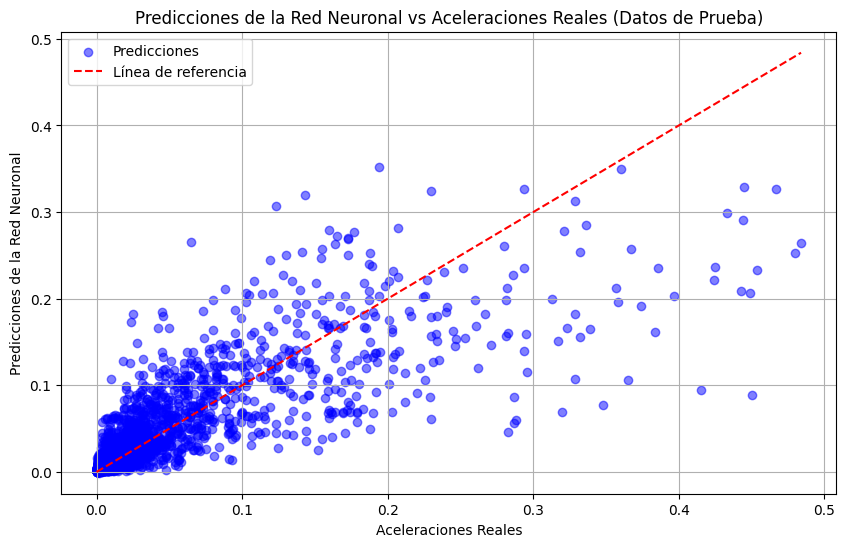

In [ ]:
import matplotlib.pyplot as plt

# Graficamos las predicciones vs las aceleraciones reales
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', alpha=0.5, label='Predicciones')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], linestyle='--', color='red', label='Línea de referencia')  # Línea de referencia (y_test = y_pred)
plt.title('Predicciones de la Red Neuronal vs Aceleraciones Reales (Datos de Prueba)')
plt.xlabel('Aceleraciones Reales')
plt.ylabel('Predicciones de la Red Neuronal')
plt.grid(True)
plt.legend()
plt.show()

In [ ]:
import pandas as pd
import torch

# Convertimos los datos de prueba a tensores de PyTorch
X_test_tensor = torch.tensor(X_test, dtype=torch.float32)

# Predicciones de la red neuronal en el conjunto de prueba
with torch.no_grad():
    predictions_tensor = model(X_test_tensor)
    predictions = predictions_tensor.numpy().flatten()

# Agregar las predicciones como una nueva columna al conjunto de datos de prueba
df_test = pd.DataFrame(X_test, columns=df_selected.columns[:-1])  # Creamos un DataFrame con las características de prueba
df_test['PGA (g)'] = y_test  # Agregamos la variable original 'PGA (g)'
df_test['Predict RNA'] = predictions  # Agregamos las predicciones como una nueva columna

# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.971648              0.121463                       0.005989   
1      0.827013              1.320849                      -0.769207   
2      2.732984             -0.831692                       2.331577   
3     -0.991328             -0.196256                      -0.769207   
4      1.092991              1.471765                       0.781185   
5     -0.773003              0.995188                      -0.769207   
6     -0.378537              0.995188                       0.781185   
7     -0.743970             -0.752263                      -0.769207   
8      1.211772              1.789483                      -0.769207   
9      5.490455              2.345490                       1.556381   
10    -0.427338             -0.172427                      -0.769207   
11     0.291703             -1.038209                       1.556381   
12    -0.056433             -0.545746                      -0.76

In [ ]:
# Ajustar la configuración de visualización para mostrar todas las filas
pd.set_option('display.max_rows', None)
# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.971648              0.121463                       0.005989   
1      0.827013              1.320849                      -0.769207   
2      2.732984             -0.831692                       2.331577   
3     -0.991328             -0.196256                      -0.769207   
4      1.092991              1.471765                       0.781185   
5     -0.773003              0.995188                      -0.769207   
6     -0.378537              0.995188                       0.781185   
7     -0.743970             -0.752263                      -0.769207   
8      1.211772              1.789483                      -0.769207   
9      5.490455              2.345490                       1.556381   
10    -0.427338             -0.172427                      -0.769207   
11     0.291703             -1.038209                       1.556381   
12    -0.056433             -0.545746                      -0.76

In [ ]:
import pandas as pd

# Cargamos el archivo CSV de validación
url_validacion = '/content/DATA_VALIDACION_200.csv'
df_validacion = pd.read_csv(url_validacion)

# Seleccionamos solo las características relevantes del DataFrame de validación
df_validacion_selected = df_validacion[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis', 'HypD (km)']]

# Convertimos los datos de validación seleccionados a tensores de PyTorch
X_validacion_tensor = torch.tensor(df_validacion_selected.values, dtype=torch.float32)

# Predicciones de la red neuronal en el conjunto de validación
with torch.no_grad():
    predictions_validacion_tensor = model(X_validacion_tensor)
    predictions_validacion = predictions_validacion_tensor.numpy().flatten()

# Agregamos las predicciones como una nueva columna al DataFrame de validación
df_validacion['Predict RNA'] = predictions_validacion

# Mostramos el DataFrame con las predicciones
print(df_validacion)

     Earthquake Magnitude  Mechanism Based on Rake Angle  EpiD (km)  \
0                    4.11                              1     215.19   
1                    4.11                              1     136.41   
2                    4.11                              1     146.01   
3                    4.11                              1     149.06   
4                    4.11                              1     135.25   
5                    4.11                              1     217.00   
6                    4.11                              1      92.01   
7                    4.11                              1     101.28   
8                    4.11                              1     179.19   
9                    4.11                              1     120.89   
10                   4.11                              1     179.25   
11                   4.11                              1     174.66   
12                   4.11                              1     120.87   
13    

**MÉTRICAS DE EVALUACIÓN**

**R2**

In [ ]:
from sklearn.metrics import r2_score

# Calculamos el coeficiente de determinación R²
r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R²:', r2)

Coeficiente de determinación R²: 0.6975193723700659


**MSE**

In [ ]:
from sklearn.metrics import mean_squared_error

# Calculamos el Error Cuadrático Medio (MSE)
mse = mean_squared_error(y_test, y_pred)
print('Error Cuadrático Medio (MSE):', mse)

Error Cuadrático Medio (MSE): 0.000906369


**RMSE**

In [ ]:
import numpy as np

# Calculamos la Raíz del Error Cuadrático Medio (RMSE)
rmse = np.sqrt(mse)
print('Raíz del Error Cuadrático Medio (RMSE):', rmse)

Raíz del Error Cuadrático Medio (RMSE): 0.030105963


**RMSLE**

In [ ]:
from sklearn.metrics import mean_squared_log_error
y_test_positive = y_test + 1
y_pred_positive = y_pred + 1

# Calculamos el Error Cuadrático Logarítmico Medio (RMSLE)
rmsle = np.sqrt(mean_squared_log_error(y_test_positive, y_pred_positive))
print('Root Mean Squared Logarithmic Error (RMSLE):', rmsle)

Root Mean Squared Logarithmic Error (RMSLE): 0.013866291


**MAE**

In [ ]:
from sklearn.metrics import mean_absolute_error

# Calculamos el Error Absoluto Medio (MAE)
mae = mean_absolute_error(y_test, y_pred)
print('Error Absoluto Medio (MAE):', mae)

Error Absoluto Medio (MAE): 0.012561923


**LIBRERÍA SCIKIT-LEARN**

**Función de activación ReLU - 1 capa de entrada de 5 neuronas y 3 capas ocultas - 100 épocas - 80% entrenamiento - 20% prueba.**

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import mean_squared_error, r2_score

# Cargamos el archivo CSV
url = '/content/DATA_PGA_050.csv'  # Ruta del archivo CSV
df = pd.read_csv(url)

# Seleccionamos solo las variables relevantes
df_selected = df[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis','HypD (km)', 'PGA (g)']]

# Dividimos los datos en características (X) y etiquetas (y)
X = df_selected.drop('PGA (g)', axis=1).values
y = df_selected['PGA (g)'].values

# Dividimos los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Escalamos los datos
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Definimos el modelo de red neuronal con Scikit-Learn
model = MLPRegressor(hidden_layer_sizes=(5, 64, 32, 16), activation='relu', solver='adam', alpha=0.0001, max_iter=100, random_state=42)

# Entrenamos el modelo
model.fit(X_train, y_train)

# Realizamos predicciones en el conjunto de prueba
y_pred = model.predict(X_test)

# Calculamos las métricas de evaluación
mse = mean_squared_error(y_test, y_pred)
print('Mean Squared Error on Test Set:', mse)

r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R²:', r2)

# Guardamos el modelo (esto es opcional en Scikit-Learn)
import joblib
joblib.dump(model, 'modelo.pkl')


Mean Squared Error on Test Set: 0.0009702042916839936
Coeficiente de determinación R²: 0.6762157575303959


['modelo.pkl']

**Matriz de Correlación**

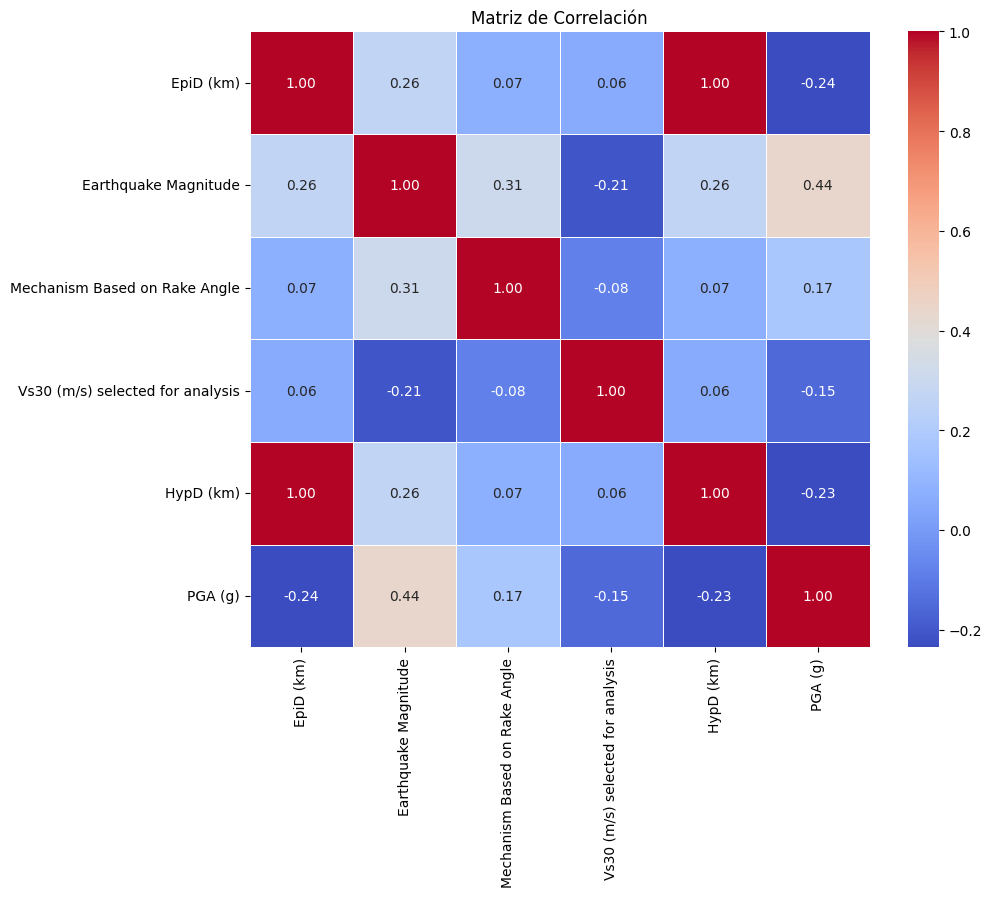

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Cargamos el archivo CSV
url = '/content/DATA_PGA_050.csv'  # Ruta del archivo CSV
df = pd.read_csv(url)

# Seleccionamos solo las variables relevantes
df_selected = df[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis', 'HypD (km)', 'PGA (g)']]

# Calculamos la matriz de correlación
correlation_matrix = df_selected.corr()

# Creamos un mapa de calor para visualizar la matriz de correlación
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Matriz de Correlación')
plt.show()


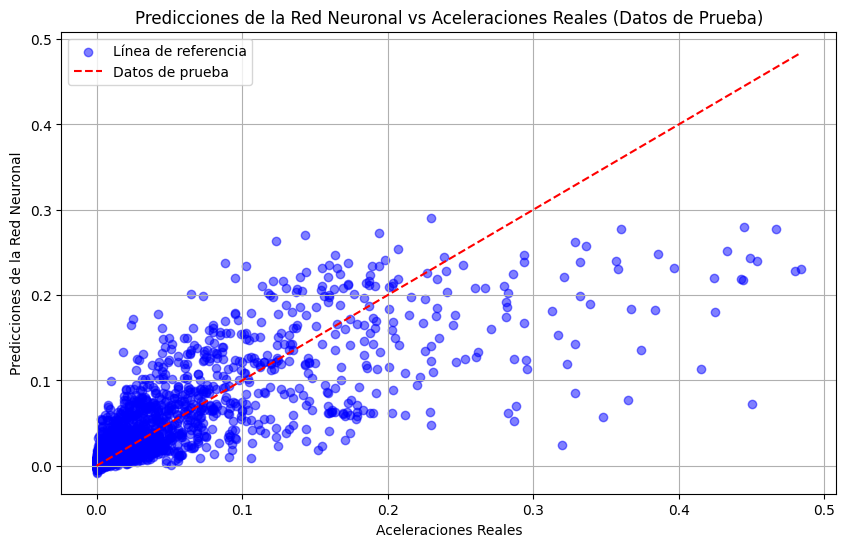

In [ ]:
import matplotlib.pyplot as plt

# Graficamos las predicciones vs las aceleraciones reales
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', alpha=0.5)
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], linestyle='--', color='red')  # Línea de referencia (y_test = y_pred)
plt.title('Predicciones de la Red Neuronal vs Aceleraciones Reales (Datos de Prueba)')
plt.xlabel('Aceleraciones Reales')
plt.ylabel('Predicciones de la Red Neuronal')
plt.grid(True)
plt.legend(['Línea de referencia', 'Datos de prueba'])
plt.show()

In [ ]:
import pandas as pd

# Predicciones de la red neuronal en el conjunto de prueba
predictions = model.predict(X_test)

# Agregar las predicciones como una nueva columna al conjunto de datos de prueba
df_test = pd.DataFrame(X_test, columns=df_selected.columns[:-1])  # Creamos un DataFrame con las características de prueba
df_test['PGA (g)'] = y_test  # Agregamos la variable original 'PGA (g)'
df_test['Predict RNA'] = predictions  # Agregamos las predicciones como una nueva columna

# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.971648              0.121463                       0.005989   
1      0.827013              1.320849                      -0.769207   
2      2.732984             -0.831692                       2.331577   
3     -0.991328             -0.196256                      -0.769207   
4      1.092991              1.471765                       0.781185   
5     -0.773003              0.995188                      -0.769207   
6     -0.378537              0.995188                       0.781185   
7     -0.743970             -0.752263                      -0.769207   
8      1.211772              1.789483                      -0.769207   
9      5.490455              2.345490                       1.556381   
10    -0.427338             -0.172427                      -0.769207   
11     0.291703             -1.038209                       1.556381   
12    -0.056433             -0.545746                      -0.76

In [ ]:
# Ajustar la configuración de visualización para mostrar todas las filas
pd.set_option('display.max_rows', None)
# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.971648              0.121463                       0.005989   
1      0.827013              1.320849                      -0.769207   
2      2.732984             -0.831692                       2.331577   
3     -0.991328             -0.196256                      -0.769207   
4      1.092991              1.471765                       0.781185   
5     -0.773003              0.995188                      -0.769207   
6     -0.378537              0.995188                       0.781185   
7     -0.743970             -0.752263                      -0.769207   
8      1.211772              1.789483                      -0.769207   
9      5.490455              2.345490                       1.556381   
10    -0.427338             -0.172427                      -0.769207   
11     0.291703             -1.038209                       1.556381   
12    -0.056433             -0.545746                      -0.76

In [ ]:
import pandas as pd

# Cargar el archivo CSV de validación
url_validacion = '/content/DATA_VALIDACION_200.csv'
df_validacion = pd.read_csv(url_validacion)

# Realizar las predicciones utilizando el modelo de red neuronal de Scikit-Learn
predictions_validacion = model.predict(df_validacion.values[:, :-1])  # Excluimos la última columna que es la variable objetivo

# Agregar las predicciones como una nueva columna al conjunto de datos de validación
df_validacion['Predict RNA'] = predictions_validacion

# Mostrar todos los registros junto con la variable Predict RNA
print(df_validacion)

     Earthquake Magnitude  Mechanism Based on Rake Angle  EpiD (km)  \
0                    4.11                              1     215.19   
1                    4.11                              1     136.41   
2                    4.11                              1     146.01   
3                    4.11                              1     149.06   
4                    4.11                              1     135.25   
5                    4.11                              1     217.00   
6                    4.11                              1      92.01   
7                    4.11                              1     101.28   
8                    4.11                              1     179.19   
9                    4.11                              1     120.89   
10                   4.11                              1     179.25   
11                   4.11                              1     174.66   
12                   4.11                              1     120.87   
13    

**MÉTRICAS DE EVALUACIÓN**

**R2**

In [ ]:
from sklearn.metrics import r2_score

# Calculamos el coeficiente de determinación R²
r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R²:', r2)

Coeficiente de determinación R²: 0.6762157575303959


**MSE**

In [ ]:
from sklearn.metrics import mean_squared_error

# Calculamos el Error Cuadrático Medio (MSE)
mse = mean_squared_error(y_test, y_pred)
print('Error Cuadrático Medio (MSE):', mse)

Error Cuadrático Medio (MSE): 0.0009702042916839936


**RMSE**

In [ ]:
import numpy as np

# Calculamos la Raíz del Error Cuadrático Medio (RMSE)
rmse = np.sqrt(mse)
print('Raíz del Error Cuadrático Medio (RMSE):', rmse)

Raíz del Error Cuadrático Medio (RMSE): 0.031148102537457936


**RMSLE**

In [ ]:
from sklearn.metrics import mean_squared_log_error
y_test_positive = y_test + 1
y_pred_positive = y_pred + 1

# Calculamos el Error Cuadrático Logarítmico Medio (RMSLE)
rmsle = np.sqrt(mean_squared_log_error(y_test_positive, y_pred_positive))
print('Root Mean Squared Logarithmic Error (RMSLE):', rmsle)

Root Mean Squared Logarithmic Error (RMSLE): 0.01437912241913216


**MAE**

In [ ]:
from sklearn.metrics import mean_absolute_error

# Calculamos el Error Absoluto Medio (MAE)
mae = mean_absolute_error(y_test, y_pred)
print('Error Absoluto Medio (MAE):', mae)

Error Absoluto Medio (MAE): 0.013976022810335963


**Función de activación ReLU - 1 capa de entrada de 5 neuronas y 3 capas ocultas - 100 épocas - 70% entrenamiento - 30% prueba.**

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import mean_squared_error, r2_score

# Cargamos el archivo CSV
url = '/content/DATA_PGA_050.csv'  # Ruta del archivo CSV
df = pd.read_csv(url)

# Seleccionamos solo las variables relevantes
df_selected = df[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis','HypD (km)', 'PGA (g)']]

# Dividimos los datos en características (X) y etiquetas (y)
X = df_selected.drop('PGA (g)', axis=1).values
y = df_selected['PGA (g)'].values

# Dividimos los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Escalamos los datos
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Definimos el modelo de red neuronal con Scikit-Learn
model = MLPRegressor(hidden_layer_sizes=(5, 64, 32, 16), activation='relu', solver='adam', alpha=0.0001, max_iter=100, random_state=42)

# Entrenamos el modelo
model.fit(X_train, y_train)

# Realizamos predicciones en el conjunto de prueba
y_pred = model.predict(X_test)

# Calculamos las métricas de evaluación
mse = mean_squared_error(y_test, y_pred)
print('Mean Squared Error on Test Set:', mse)

r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R²:', r2)

# Guardamos el modelo (esto es opcional en Scikit-Learn)
import joblib
joblib.dump(model, 'modelo.pkl')

Mean Squared Error on Test Set: 0.0010772763301066465
Coeficiente de determinación R²: 0.6509751010927565


['modelo.pkl']

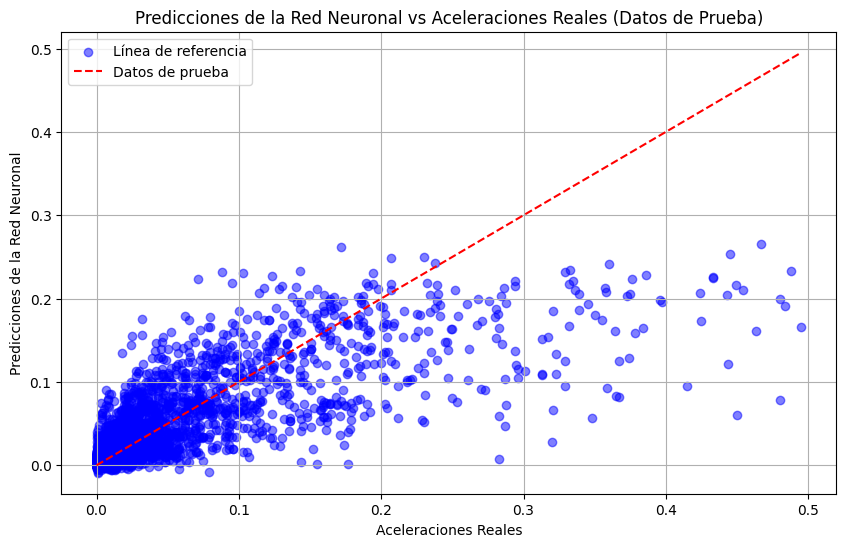

In [ ]:
import matplotlib.pyplot as plt

# Graficamos las predicciones vs las aceleraciones reales
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', alpha=0.5)
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], linestyle='--', color='red')  # Línea de referencia (y_test = y_pred)
plt.title('Predicciones de la Red Neuronal vs Aceleraciones Reales (Datos de Prueba)')
plt.xlabel('Aceleraciones Reales')
plt.ylabel('Predicciones de la Red Neuronal')
plt.grid(True)
plt.legend(['Línea de referencia', 'Datos de prueba'])
plt.show()

In [ ]:
import pandas as pd

# Predicciones de la red neuronal en el conjunto de prueba
predictions = model.predict(X_test)

# Agregar las predicciones como una nueva columna al conjunto de datos de prueba
df_test = pd.DataFrame(X_test, columns=df_selected.columns[:-1])  # Creamos un DataFrame con las características de prueba
df_test['PGA (g)'] = y_test  # Agregamos la variable original 'PGA (g)'
df_test['Predict RNA'] = predictions  # Agregamos las predicciones como una nueva columna

# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.958670              0.121924                       0.004438   
1      0.819170              1.320204                      -0.770187   
2      2.703078             -0.830352                       2.328313   
3     -0.978122             -0.195501                      -0.770187   
4      1.082070              1.470981                       0.779063   
5     -0.762324              0.994843                      -0.770187   
6     -0.372424              0.994843                       0.779063   
7     -0.733627             -0.750995                      -0.770187   
8      1.199476              1.788406                      -0.770187   
9      5.428629              2.343900                       1.553688   
10    -0.420660             -0.171695                      -0.770187   
11     0.290057             -1.036678                       1.553688   
12    -0.054049             -0.544669                      -0.77

In [ ]:
# Ajustar la configuración de visualización para mostrar todas las filas
pd.set_option('display.max_rows', None)
# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.958670              0.121924                       0.004438   
1      0.819170              1.320204                      -0.770187   
2      2.703078             -0.830352                       2.328313   
3     -0.978122             -0.195501                      -0.770187   
4      1.082070              1.470981                       0.779063   
5     -0.762324              0.994843                      -0.770187   
6     -0.372424              0.994843                       0.779063   
7     -0.733627             -0.750995                      -0.770187   
8      1.199476              1.788406                      -0.770187   
9      5.428629              2.343900                       1.553688   
10    -0.420660             -0.171695                      -0.770187   
11     0.290057             -1.036678                       1.553688   
12    -0.054049             -0.544669                      -0.77

In [ ]:
import pandas as pd

# Cargar el archivo CSV de validación
url_validacion = '/content/DATA_VALIDACION_200.csv'
df_validacion = pd.read_csv(url_validacion)

# Realizar las predicciones utilizando el modelo de red neuronal de Scikit-Learn
predictions_validacion = model.predict(df_validacion.values[:, :-1])  # Excluimos la última columna que es la variable objetivo

# Agregar las predicciones como una nueva columna al conjunto de datos de validación
df_validacion['Predict RNA'] = predictions_validacion

# Mostrar todos los registros junto con la variable Predict RNA
print(df_validacion)

     Earthquake Magnitude  Mechanism Based on Rake Angle  EpiD (km)  \
0                    4.11                              1     215.19   
1                    4.11                              1     136.41   
2                    4.11                              1     146.01   
3                    4.11                              1     149.06   
4                    4.11                              1     135.25   
5                    4.11                              1     217.00   
6                    4.11                              1      92.01   
7                    4.11                              1     101.28   
8                    4.11                              1     179.19   
9                    4.11                              1     120.89   
10                   4.11                              1     179.25   
11                   4.11                              1     174.66   
12                   4.11                              1     120.87   
13    

**MÉTRICAS DE EVALUACIÓN**

**R2**

In [ ]:
from sklearn.metrics import r2_score

# Calculamos el coeficiente de determinación R²
r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R²:', r2)

Coeficiente de determinación R²: 0.6509751010927565


**MSE**

In [ ]:
from sklearn.metrics import mean_squared_error

# Calculamos el Error Cuadrático Medio (MSE)
mse = mean_squared_error(y_test, y_pred)
print('Error Cuadrático Medio (MSE):', mse)

Error Cuadrático Medio (MSE): 0.0010772763301066465


**RMSE**

In [ ]:
import numpy as np

# Calculamos la Raíz del Error Cuadrático Medio (RMSE)
rmse = np.sqrt(mse)
print('Raíz del Error Cuadrático Medio (RMSE):', rmse)

Raíz del Error Cuadrático Medio (RMSE): 0.03282188797291598


**RMSLE**

In [ ]:
from sklearn.metrics import mean_squared_log_error
y_test_positive = y_test + 1
y_pred_positive = y_pred + 1

# Calculamos el Error Cuadrático Logarítmico Medio (RMSLE)
rmsle = np.sqrt(mean_squared_log_error(y_test_positive, y_pred_positive))
print('Root Mean Squared Logarithmic Error (RMSLE):', rmsle)

Root Mean Squared Logarithmic Error (RMSLE): 0.015102502166203739


**MAE**

In [ ]:
from sklearn.metrics import mean_absolute_error

# Calculamos el Error Absoluto Medio (MAE)
mae = mean_absolute_error(y_test, y_pred)
print('Error Absoluto Medio (MAE):', mae)

Error Absoluto Medio (MAE): 0.01407588260799092


**Función de activación ReLU - 1 capa de entrada de 5 neuronas y 3 capas ocultas - 100 épocas - 90% entrenamiento - 10% prueba.**

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import mean_squared_error, r2_score

# Cargamos el archivo CSV
url = '/content/DATA_PGA_050.csv'  # Ruta del archivo CSV
df = pd.read_csv(url)

# Seleccionamos solo las variables relevantes
df_selected = df[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis','HypD (km)', 'PGA (g)']]

# Dividimos los datos en características (X) y etiquetas (y)
X = df_selected.drop('PGA (g)', axis=1).values
y = df_selected['PGA (g)'].values

# Dividimos los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42)

# Escalamos los datos
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Definimos el modelo de red neuronal con Scikit-Learn
model = MLPRegressor(hidden_layer_sizes=(5, 64, 32, 16), activation='relu', solver='adam', alpha=0.0001, max_iter=100, random_state=42)

# Entrenamos el modelo
model.fit(X_train, y_train)

# Realizamos predicciones en el conjunto de prueba
y_pred = model.predict(X_test)

# Calculamos las métricas de evaluación
mse = mean_squared_error(y_test, y_pred)
print('Mean Squared Error on Test Set:', mse)

r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R²:', r2)

# Guardamos el modelo (esto es opcional en Scikit-Learn)
import joblib
joblib.dump(model, 'modelo.pkl')

Mean Squared Error on Test Set: 0.0009729790599683104
Coeficiente de determinación R²: 0.6847164375632868


['modelo.pkl']

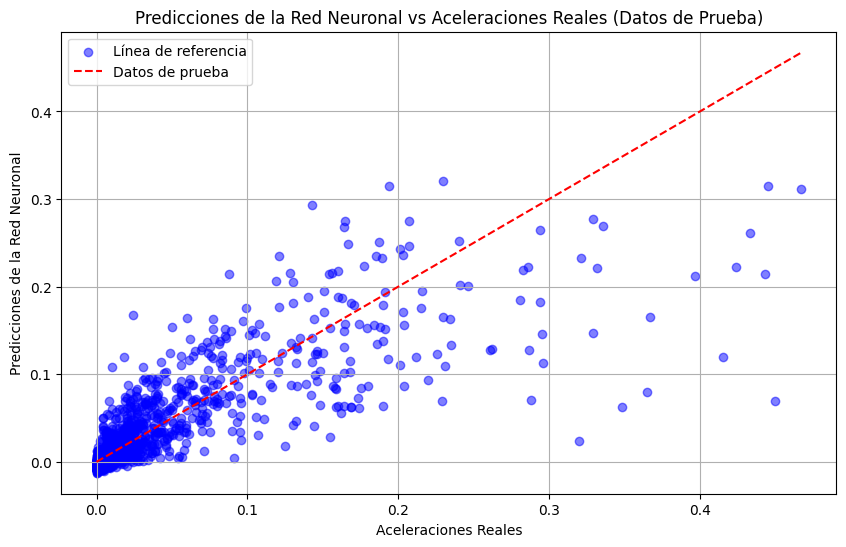

In [ ]:
import matplotlib.pyplot as plt

# Graficamos las predicciones vs las aceleraciones reales
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', alpha=0.5)
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], linestyle='--', color='red')  # Línea de referencia (y_test = y_pred)
plt.title('Predicciones de la Red Neuronal vs Aceleraciones Reales (Datos de Prueba)')
plt.xlabel('Aceleraciones Reales')
plt.ylabel('Predicciones de la Red Neuronal')
plt.grid(True)
plt.legend(['Línea de referencia', 'Datos de prueba'])
plt.show()

In [ ]:
import pandas as pd

# Predicciones de la red neuronal en el conjunto de prueba
predictions = model.predict(X_test)

# Agregar las predicciones como una nueva columna al conjunto de datos de prueba
df_test = pd.DataFrame(X_test, columns=df_selected.columns[:-1])  # Creamos un DataFrame con las características de prueba
df_test['PGA (g)'] = y_test  # Agregamos la variable original 'PGA (g)'
df_test['Predict RNA'] = predictions  # Agregamos las predicciones como una nueva columna

# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.968945              0.122893                       0.005614   
1      0.825426              1.321808                      -0.770449   
2      2.726850             -0.829887                       2.333802   
3     -0.988577             -0.194700                      -0.770449   
4      1.090769              1.472665                       0.781676   
5     -0.770774              0.996275                      -0.770449   
6     -0.377248              0.996275                       0.781676   
7     -0.741810             -0.750488                      -0.770449   
8      1.209267              1.790258                      -0.770449   
9      5.477743              2.346047                       1.557739   
10    -0.425933             -0.170881                      -0.770449   
11     0.291393             -1.036323                       1.557739   
12    -0.055913             -0.544053                      -0.77

In [ ]:
# Ajustar la configuración de visualización para mostrar todas las filas
pd.set_option('display.max_rows', None)
# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.968945              0.122893                       0.005614   
1      0.825426              1.321808                      -0.770449   
2      2.726850             -0.829887                       2.333802   
3     -0.988577             -0.194700                      -0.770449   
4      1.090769              1.472665                       0.781676   
5     -0.770774              0.996275                      -0.770449   
6     -0.377248              0.996275                       0.781676   
7     -0.741810             -0.750488                      -0.770449   
8      1.209267              1.790258                      -0.770449   
9      5.477743              2.346047                       1.557739   
10    -0.425933             -0.170881                      -0.770449   
11     0.291393             -1.036323                       1.557739   
12    -0.055913             -0.544053                      -0.77

In [ ]:
import pandas as pd

# Cargar el archivo CSV de validación
url_validacion = '/content/DATA_VALIDACION_200.csv'
df_validacion = pd.read_csv(url_validacion)

# Realizar las predicciones utilizando el modelo de red neuronal de Scikit-Learn
predictions_validacion = model.predict(df_validacion.values[:, :-1])  # Excluimos la última columna que es la variable objetivo

# Agregar las predicciones como una nueva columna al conjunto de datos de validación
df_validacion['Predict RNA'] = predictions_validacion

# Mostrar todos los registros junto con la variable Predict RNA
print(df_validacion)

     Earthquake Magnitude  Mechanism Based on Rake Angle  EpiD (km)  \
0                    4.11                              1     215.19   
1                    4.11                              1     136.41   
2                    4.11                              1     146.01   
3                    4.11                              1     149.06   
4                    4.11                              1     135.25   
5                    4.11                              1     217.00   
6                    4.11                              1      92.01   
7                    4.11                              1     101.28   
8                    4.11                              1     179.19   
9                    4.11                              1     120.89   
10                   4.11                              1     179.25   
11                   4.11                              1     174.66   
12                   4.11                              1     120.87   
13    

**MÉTRICAS DE EVALUACIÓN**

**R2**

In [ ]:
from sklearn.metrics import r2_score

# Calculamos el coeficiente de determinación R²
r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R²:', r2)

Coeficiente de determinación R²: 0.6847164375632868


**MSE**

In [ ]:
from sklearn.metrics import mean_squared_error

# Calculamos el Error Cuadrático Medio (MSE)
mse = mean_squared_error(y_test, y_pred)
print('Error Cuadrático Medio (MSE):', mse)

Error Cuadrático Medio (MSE): 0.0009729790599683104


**RMSE**

In [ ]:
import numpy as np

# Calculamos la Raíz del Error Cuadrático Medio (RMSE)
rmse = np.sqrt(mse)
print('Raíz del Error Cuadrático Medio (RMSE):', rmse)

Raíz del Error Cuadrático Medio (RMSE): 0.03119261226586049


**RMSLE**

In [ ]:
from sklearn.metrics import mean_squared_log_error
y_test_positive = y_test + 1
y_pred_positive = y_pred + 1

# Calculamos el Error Cuadrático Logarítmico Medio (RMSLE)
rmsle = np.sqrt(mean_squared_log_error(y_test_positive, y_pred_positive))
print('Root Mean Squared Logarithmic Error (RMSLE):', rmsle)

Root Mean Squared Logarithmic Error (RMSLE): 0.014393148700115908


**MAE**

In [ ]:
from sklearn.metrics import mean_absolute_error

# Calculamos el Error Absoluto Medio (MAE)
mae = mean_absolute_error(y_test, y_pred)
print('Error Absoluto Medio (MAE):', mae)

Error Absoluto Medio (MAE): 0.01495671169494033


**Función de activación Tangente Hipérbolica - 1 capa de entrada de 5 neuronas y 3 capas ocultas - 100 épocas - 80% entrenamiento - 20% prueba.**

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import mean_squared_error, r2_score

# Cargamos el archivo CSV
url = '/content/DATA_PGA_050.csv'  # Ruta del archivo CSV
df = pd.read_csv(url)

# Seleccionamos solo las variables relevantes
df_selected = df[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis','HypD (km)', 'PGA (g)']]

# Dividimos los datos en características (X) y etiquetas (y)
X = df_selected.drop('PGA (g)', axis=1).values
y = df_selected['PGA (g)'].values

# Dividimos los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Escalamos los datos
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Definimos el modelo de red neuronal con Scikit-Learn y la función de activación Tangente Hiperbólica
model = MLPRegressor(hidden_layer_sizes=(5, 64, 32, 16), activation='tanh', solver='adam', alpha=0.0001, max_iter=100, random_state=42)

# Entrenamos el modelo
model.fit(X_train, y_train)

# Realizamos predicciones en el conjunto de prueba
y_pred = model.predict(X_test)

# Calculamos las métricas de evaluación
mse = mean_squared_error(y_test, y_pred)
print('Mean Squared Error on Test Set:', mse)

r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R²:', r2)

# Guardamos el modelo (esto es opcional en Scikit-Learn)
import joblib
joblib.dump(model, 'modelo.pkl')


Mean Squared Error on Test Set: 0.0012351534733923816
Coeficiente de determinación R²: 0.5877948230656641


['modelo.pkl']

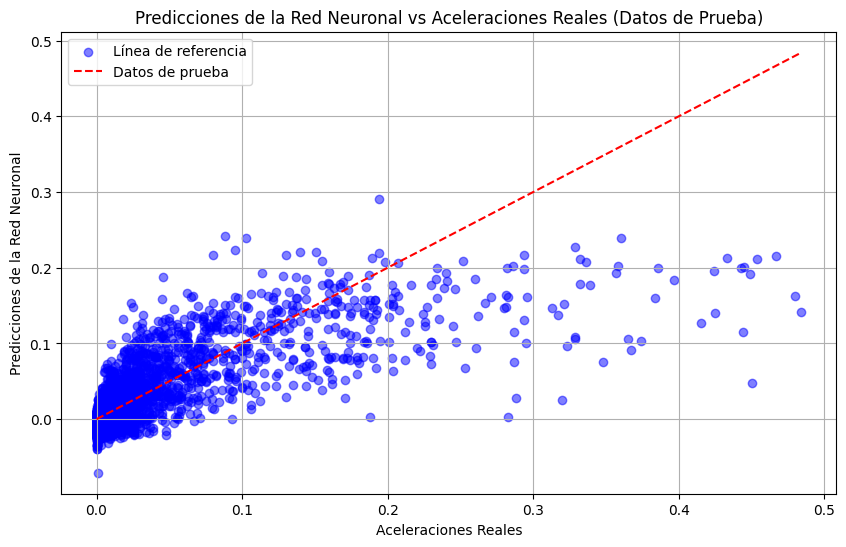

In [ ]:
import matplotlib.pyplot as plt

# Graficamos las predicciones vs las aceleraciones reales
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', alpha=0.5)
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], linestyle='--', color='red')  # Línea de referencia (y_test = y_pred)
plt.title('Predicciones de la Red Neuronal vs Aceleraciones Reales (Datos de Prueba)')
plt.xlabel('Aceleraciones Reales')
plt.ylabel('Predicciones de la Red Neuronal')
plt.grid(True)
plt.legend(['Línea de referencia', 'Datos de prueba'])
plt.show()

In [ ]:
import pandas as pd

# Predicciones de la red neuronal en el conjunto de prueba
predictions = model.predict(X_test)

# Agregar las predicciones como una nueva columna al conjunto de datos de prueba
df_test = pd.DataFrame(X_test, columns=df_selected.columns[:-1])  # Creamos un DataFrame con las características de prueba
df_test['PGA (g)'] = y_test  # Agregamos la variable original 'PGA (g)'
df_test['Predict RNA'] = predictions  # Agregamos las predicciones como una nueva columna

# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.971648              0.121463                       0.005989   
1      0.827013              1.320849                      -0.769207   
2      2.732984             -0.831692                       2.331577   
3     -0.991328             -0.196256                      -0.769207   
4      1.092991              1.471765                       0.781185   
5     -0.773003              0.995188                      -0.769207   
6     -0.378537              0.995188                       0.781185   
7     -0.743970             -0.752263                      -0.769207   
8      1.211772              1.789483                      -0.769207   
9      5.490455              2.345490                       1.556381   
10    -0.427338             -0.172427                      -0.769207   
11     0.291703             -1.038209                       1.556381   
12    -0.056433             -0.545746                      -0.76

In [ ]:
# Ajustar la configuración de visualización para mostrar todas las filas
pd.set_option('display.max_rows', None)
# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.971648              0.121463                       0.005989   
1      0.827013              1.320849                      -0.769207   
2      2.732984             -0.831692                       2.331577   
3     -0.991328             -0.196256                      -0.769207   
4      1.092991              1.471765                       0.781185   
5     -0.773003              0.995188                      -0.769207   
6     -0.378537              0.995188                       0.781185   
7     -0.743970             -0.752263                      -0.769207   
8      1.211772              1.789483                      -0.769207   
9      5.490455              2.345490                       1.556381   
10    -0.427338             -0.172427                      -0.769207   
11     0.291703             -1.038209                       1.556381   
12    -0.056433             -0.545746                      -0.76

In [ ]:
import pandas as pd

# Cargar el archivo CSV de validación
url_validacion = '/content/DATA_VALIDACION_200.csv'
df_validacion = pd.read_csv(url_validacion)

# Realizar las predicciones utilizando el modelo de red neuronal de Scikit-Learn
predictions_validacion = model.predict(df_validacion.values[:, :-1])  # Excluimos la última columna que es la variable objetivo

# Agregar las predicciones como una nueva columna al conjunto de datos de validación
df_validacion['Predict RNA'] = predictions_validacion

# Mostrar todos los registros junto con la variable Predict RNA
print(df_validacion)

     Earthquake Magnitude  Mechanism Based on Rake Angle  EpiD (km)  \
0                    4.11                              1     215.19   
1                    4.11                              1     136.41   
2                    4.11                              1     146.01   
3                    4.11                              1     149.06   
4                    4.11                              1     135.25   
5                    4.11                              1     217.00   
6                    4.11                              1      92.01   
7                    4.11                              1     101.28   
8                    4.11                              1     179.19   
9                    4.11                              1     120.89   
10                   4.11                              1     179.25   
11                   4.11                              1     174.66   
12                   4.11                              1     120.87   
13    

**MÉTRICAS DE EVALUACIÓN**

**R2**

In [ ]:
from sklearn.metrics import r2_score

# Calculamos el coeficiente de determinación R²
r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R²:', r2)

Coeficiente de determinación R²: 0.5877948230656641


**MSE**

In [ ]:
from sklearn.metrics import mean_squared_error

# Calculamos el Error Cuadrático Medio (MSE)
mse = mean_squared_error(y_test, y_pred)
print('Error Cuadrático Medio (MSE):', mse)

Error Cuadrático Medio (MSE): 0.0012351534733923816


**RMSE**

In [ ]:
import numpy as np

# Calculamos la Raíz del Error Cuadrático Medio (RMSE)
rmse = np.sqrt(mse)
print('Raíz del Error Cuadrático Medio (RMSE):', rmse)

Raíz del Error Cuadrático Medio (RMSE): 0.03514475029634414


**RMSLE**

In [ ]:
from sklearn.metrics import mean_squared_log_error
y_test_positive = y_test + 1
y_pred_positive = y_pred + 1

# Calculamos el Error Cuadrático Logarítmico Medio (RMSLE)
rmsle = np.sqrt(mean_squared_log_error(y_test_positive, y_pred_positive))
print('Root Mean Squared Logarithmic Error (RMSLE):', rmsle)

Root Mean Squared Logarithmic Error (RMSLE): 0.016322144513047636


**MAE**

In [ ]:
from sklearn.metrics import mean_absolute_error

# Calculamos el Error Absoluto Medio (MAE)
mae = mean_absolute_error(y_test, y_pred)
print('Error Absoluto Medio (MAE):', mae)

Error Absoluto Medio (MAE): 0.01930261864508338


**Función de activación Sigmoide - 1 capa de entrada de 5 neuronas y 3 capas ocultas - 100 épocas - 80% entrenamiento - 20% prueba.**

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import mean_squared_error, r2_score

# Cargamos el archivo CSV
url = '/content/DATA_PGA_050.csv'  # Ruta del archivo CSV
df = pd.read_csv(url)

# Seleccionamos solo las variables relevantes
df_selected = df[['EpiD (km)', 'Earthquake Magnitude', 'Mechanism Based on Rake Angle', 'Vs30 (m/s) selected for analysis','HypD (km)', 'PGA (g)']]

# Dividimos los datos en características (X) y etiquetas (y)
X = df_selected.drop('PGA (g)', axis=1).values
y = df_selected['PGA (g)'].values

# Dividimos los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Escalamos los datos
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Definimos el modelo de red neuronal con Scikit-Learn y la función de activación Sigmoide
model = MLPRegressor(hidden_layer_sizes=(5, 64, 32, 16), activation='logistic', solver='adam', alpha=0.0001, max_iter=100, random_state=42)

# Entrenamos el modelo
model.fit(X_train, y_train)

# Realizamos predicciones en el conjunto de prueba
y_pred = model.predict(X_test)

# Calculamos las métricas de evaluación
mse = mean_squared_error(y_test, y_pred)
print('Mean Squared Error on Test Set:', mse)

r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R²:', r2)

# Guardamos el modelo (esto es opcional en Scikit-Learn)
import joblib
joblib.dump(model, 'modelo.pkl')



Mean Squared Error on Test Set: 0.001263031293679278
Coeficiente de determinación R²: 0.5784912165977631


['modelo.pkl']

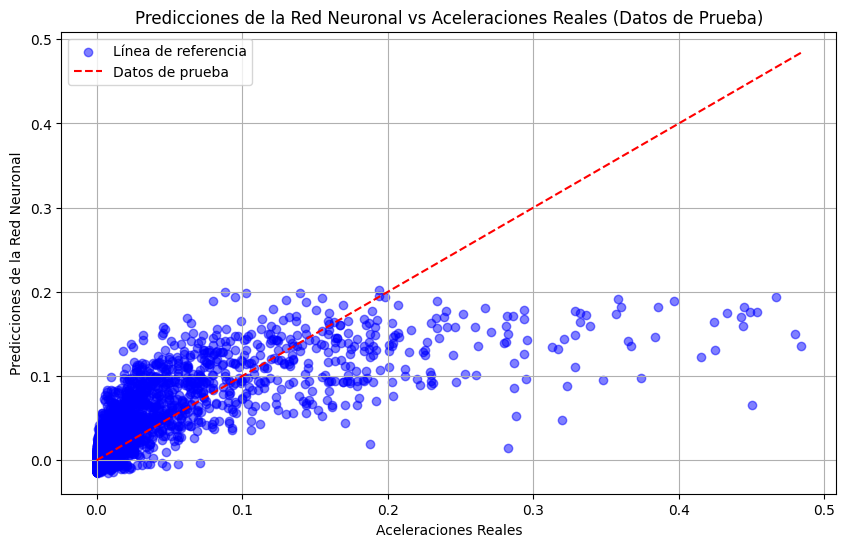

In [ ]:
import matplotlib.pyplot as plt

# Graficamos las predicciones vs las aceleraciones reales
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', alpha=0.5)
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], linestyle='--', color='red')  # Línea de referencia (y_test = y_pred)
plt.title('Predicciones de la Red Neuronal vs Aceleraciones Reales (Datos de Prueba)')
plt.xlabel('Aceleraciones Reales')
plt.ylabel('Predicciones de la Red Neuronal')
plt.grid(True)
plt.legend(['Línea de referencia', 'Datos de prueba'])
plt.show()

In [ ]:
import pandas as pd

# Predicciones de la red neuronal en el conjunto de prueba
predictions = model.predict(X_test)

# Agregar las predicciones como una nueva columna al conjunto de datos de prueba
df_test = pd.DataFrame(X_test, columns=df_selected.columns[:-1])  # Creamos un DataFrame con las características de prueba
df_test['PGA (g)'] = y_test  # Agregamos la variable original 'PGA (g)'
df_test['Predict RNA'] = predictions  # Agregamos las predicciones como una nueva columna

# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.971648              0.121463                       0.005989   
1      0.827013              1.320849                      -0.769207   
2      2.732984             -0.831692                       2.331577   
3     -0.991328             -0.196256                      -0.769207   
4      1.092991              1.471765                       0.781185   
...         ...                   ...                            ...   
4235   2.082599             -0.990551                      -0.769207   
4236  -0.865663             -0.172427                      -0.769207   
4237  -0.961853              1.074617                       0.005989   
4238   0.737618              1.471765                       0.781185   
4239  -0.900080             -0.776092                      -0.769207   

      Vs30 (m/s) selected for analysis  HypD (km)  PGA (g)  Predict RNA  
0                             0.262777  -0.961443    0.148   

In [ ]:
# Ajustar la configuración de visualización para mostrar todas las filas
pd.set_option('display.max_rows', None)
# Mostrar todo el dataset con las predicciones
print(df_test)

      EpiD (km)  Earthquake Magnitude  Mechanism Based on Rake Angle  \
0     -0.971648              0.121463                       0.005989   
1      0.827013              1.320849                      -0.769207   
2      2.732984             -0.831692                       2.331577   
3     -0.991328             -0.196256                      -0.769207   
4      1.092991              1.471765                       0.781185   
5     -0.773003              0.995188                      -0.769207   
6     -0.378537              0.995188                       0.781185   
7     -0.743970             -0.752263                      -0.769207   
8      1.211772              1.789483                      -0.769207   
9      5.490455              2.345490                       1.556381   
10    -0.427338             -0.172427                      -0.769207   
11     0.291703             -1.038209                       1.556381   
12    -0.056433             -0.545746                      -0.76

In [ ]:
import pandas as pd

# Cargar el archivo CSV de validación
url_validacion = '/content/DATA_VALIDACION_200.csv'
df_validacion = pd.read_csv(url_validacion)

# Realizar las predicciones utilizando el modelo de red neuronal de Scikit-Learn
predictions_validacion = model.predict(df_validacion.values[:, :-1])  # Excluimos la última columna que es la variable objetivo

# Agregar las predicciones como una nueva columna al conjunto de datos de validación
df_validacion['Predict RNA'] = predictions_validacion

# Mostrar todos los registros junto con la variable Predict RNA
print(df_validacion)

     Earthquake Magnitude  Mechanism Based on Rake Angle  EpiD (km)  \
0                    4.11                              1     215.19   
1                    4.11                              1     136.41   
2                    4.11                              1     146.01   
3                    4.11                              1     149.06   
4                    4.11                              1     135.25   
5                    4.11                              1     217.00   
6                    4.11                              1      92.01   
7                    4.11                              1     101.28   
8                    4.11                              1     179.19   
9                    4.11                              1     120.89   
10                   4.11                              1     179.25   
11                   4.11                              1     174.66   
12                   4.11                              1     120.87   
13    

**MÉTRICAS DE EVALUACIÓN**

**R2**

In [ ]:
from sklearn.metrics import r2_score

# Calculamos el coeficiente de determinación R²
r2 = r2_score(y_test, y_pred)
print('Coeficiente de determinación R²:', r2)

Coeficiente de determinación R²: 0.5784912165977631


**MSE**

In [ ]:
from sklearn.metrics import mean_squared_error

# Calculamos el Error Cuadrático Medio (MSE)
mse = mean_squared_error(y_test, y_pred)
print('Error Cuadrático Medio (MSE):', mse)

Error Cuadrático Medio (MSE): 0.001263031293679278


**RMSE**

In [ ]:
import numpy as np

# Calculamos la Raíz del Error Cuadrático Medio (RMSE)
rmse = np.sqrt(mse)
print('Raíz del Error Cuadrático Medio (RMSE):', rmse)

Raíz del Error Cuadrático Medio (RMSE): 0.035539151561049934


**RMSLE**

In [ ]:
from sklearn.metrics import mean_squared_log_error
y_test_positive = y_test + 1
y_pred_positive = y_pred + 1

# Calculamos el Error Cuadrático Logarítmico Medio (RMSLE)
rmsle = np.sqrt(mean_squared_log_error(y_test_positive, y_pred_positive))
print('Root Mean Squared Logarithmic Error (RMSLE):', rmsle)

Root Mean Squared Logarithmic Error (RMSLE): 0.01647414007204727


**MAE**

In [ ]:
from sklearn.metrics import mean_absolute_error

# Calculamos el Error Absoluto Medio (MAE)
mae = mean_absolute_error(y_test, y_pred)
print('Error Absoluto Medio (MAE):', mae)

Error Absoluto Medio (MAE): 0.019404867903970602
